In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [2]:
import multiprocessing
from torch import autograd
from fastai.conv_learner import *
from fasterai.images import *
from fasterai.dataset import *
from fasterai.visualize import *
from fastai.torch_imports import *
from pathlib import Path
from itertools import repeat
import tensorboardX
torch.cuda.set_device(2)
plt.style.use('dark_background')
torch.backends.cudnn.benchmark=True


/home/jason/anaconda3/envs/fastai/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/home/jason/anaconda3/envs/fastai/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/home/jason/anaconda3/envs/fastai/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/home/jason/anaconda3/envs/fastai/lib/python3.6/site-packages/sklearn/ensemble/weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d


In [3]:
DATA_PATH = Path('data/imagenet/ILSVRC/Data/CLS-LOC')
TRAIN_SOURCE_PATH = DATA_PATH/'train'
uid = 'bw2color'
D_MODEL_SAVE_PATH = DATA_PATH/(uid + '_115_D.h5')
G_MODEL_SAVE_PATH = DATA_PATH/(uid + '_115_G.h5')
#keep_pct=0.02
keep_pct=1.0
#keep_pct=0.005
#keep_pct=1.0

In [4]:
def get_model_data(image_size: int, batch_size: int, keep_pct: float):
    TRAIN_X_PATH = generate_image_preprocess_path(TRAIN_SOURCE_PATH, is_x=True, size=image_size, uid=uid)
    TRAIN_Y_PATH = generate_image_preprocess_path(TRAIN_SOURCE_PATH, is_x=False, size=image_size, uid=uid)
    x_paths, y_paths = get_matched_xy_file_lists(TRAIN_X_PATH, TRAIN_Y_PATH)
    x_paths_str = convert_paths_to_str(x_paths)
    y_paths_str = convert_paths_to_str(y_paths)
    print(x_paths_str[:5])
    print(y_paths_str[:5])
    np.random.seed(42)
    keeps = np.random.rand(len(x_paths_str)) < keep_pct
    fnames_x = np.array(x_paths_str, copy=False)[keeps]
    fnames_y = np.array(y_paths_str, copy=False)[keeps]
    val_idxs = get_cv_idxs(len(fnames_x), val_pct=min(0.01/keep_pct, 0.1))
    ((val_x,trn_x),(val_y,trn_y)) = split_by_idx(val_idxs, np.array(fnames_x), np.array(fnames_y))
    img_fn = TRAIN_Y_PATH/'n01558993'/'n01558993_9684.JPEG'
    tfms = tfms_from_stats(inception_stats, image_size, tfm_y=TfmType.PIXEL, aug_tfms=transforms_side_on, sz_y=image_size)
    datasets = ImageData.get_ds(MatchedFilesDataset, (trn_x,trn_y), (val_x,val_y), tfms, path=TRAIN_Y_PATH.parent)
    md = ImageData(DATA_PATH, datasets, batch_size, num_workers=16, classes=None)
    return md

In [5]:
md = get_model_data(image_size=224, batch_size=128, keep_pct=keep_pct)
denorm = md.val_ds.denorm

['train_x_bw2color_224/n01440764/n01440764_10026.JPEG', 'train_x_bw2color_224/n01440764/n01440764_10027.JPEG', 'train_x_bw2color_224/n01440764/n01440764_10029.JPEG', 'train_x_bw2color_224/n01440764/n01440764_10040.JPEG', 'train_x_bw2color_224/n01440764/n01440764_10042.JPEG']
['train_y_bw2color_224/n01440764/n01440764_10026.JPEG', 'train_y_bw2color_224/n01440764/n01440764_10027.JPEG', 'train_y_bw2color_224/n01440764/n01440764_10029.JPEG', 'train_y_bw2color_224/n01440764/n01440764_10040.JPEG', 'train_y_bw2color_224/n01440764/n01440764_10042.JPEG']


In [6]:
def generate_denormed_image_pairs(ds: FilesDataset, batches: [(ndarray,ndarray)], idx:int = 0):
    return [(ds.denorm(x)[idx], ds.denorm(y)[idx])for (x,y) in batches]

## EDSR Model

##### TODO:  Also try making the loss/output based on "classification" like in Zhang et al.
##### TODO:  After making unet version- plug that into a Weiserman GAN setup (the discrimator looks at grey image and colorized image, concatenated together via channels).
##### TODO:  Try using higher res images (from FloydHub blog?)
##### TODO:  Try perceptual loss again....
##### TODO:  To convert real old photos, could force them to normal grayscale first.
##### TODO:  Add tensorboard graphs

In [7]:
def icnr(x, scale=2, init=nn.init.kaiming_normal):
    new_shape = [int(x.shape[0] / (scale ** 2))] + list(x.shape[1:])
    subkernel = torch.zeros(new_shape)
    subkernel = init(subkernel)
    subkernel = subkernel.transpose(0, 1)
    subkernel = subkernel.contiguous().view(subkernel.shape[0],
                                            subkernel.shape[1], -1)
    kernel = subkernel.repeat(1, 1, scale ** 2)
    transposed_shape = [x.shape[1]] + [x.shape[0]] + list(x.shape[2:])
    kernel = kernel.contiguous().view(transposed_shape)
    kernel = kernel.transpose(0, 1)
    return kernel

In [8]:
class SaveFeatures():
    features=None
    def __init__(self, m): 
        self.hook = m.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, input, output): 
        self.features = output
    def remove(self): 
        self.hook.remove()

In [9]:
class FeatureLoss(nn.Module):
    def __init__(self, block_wgts: [float] = [0.2,0.7,0.1]):
        super().__init__()
        m_vgg = vgg16(True)
        
        blocks = [i-1 for i,o in enumerate(children(m_vgg))
              if isinstance(o,nn.MaxPool2d)]
        blocks, [m_vgg[i] for i in blocks]
        layer_ids = blocks[:3]
        
        vgg_layers = children(m_vgg)[:23]
        m_vgg = nn.Sequential(*vgg_layers).cuda().eval()
        set_trainable(m_vgg, False)
        
        self.m,self.wgts = m_vgg,block_wgts
        self.sfs = [SaveFeatures(m_vgg[i]) for i in layer_ids]

    def forward(self, input, target, sum_layers=True):
        self.m(VV(target.data))
        res = [F.l1_loss(input,target)/100]
        targ_feat = [V(o.features.data.clone()) for o in self.sfs]
        self.m(input)
        res += [F.l1_loss(self.flatten(inp.features),self.flatten(targ))*wgt
               for inp,targ,wgt in zip(self.sfs, targ_feat, self.wgts)]
        if sum_layers: res = sum(res)
        return res
    
    def flatten(self, x): 
        return x.view(x.size(0), -1)
    
    def close(self):
        for o in self.sfs: o.remove()

In [10]:
def conv(ni, nf, kernel_size=3, actn=False, stride=1, normalizer=None):
    layers = [nn.Conv2d(ni, nf, kernel_size, padding=kernel_size//2, stride=stride)]
    if normalizer is not None: layers.append(normalizer)
    if actn: layers.append(nn.LeakyReLU())
    return nn.Sequential(*layers)

In [11]:
class UpSampleBlock(nn.Module):
    def __init__(self, ni, nf, scale=2):
        super().__init__()
        layers = []
        for i in range(int(math.log(scale,2))):
            layers += [conv(ni, nf*4), nn.PixelShuffle(2)]
        self.sequence = nn.Sequential(*layers)
        self.icnr_init()
        
    def icnr_init(self):
        conv_shuffle = self.sequence[0][0]
        kernel = icnr(conv_shuffle.weight)
        conv_shuffle.weight.data.copy_(kernel);
    
    def forward(self, x):
        return self.sequence(x)

In [12]:
class ResSequential(nn.Module):
    def __init__(self, layers, res_scale=1.0):
        super().__init__()
        self.res_scale = res_scale
        self.m = nn.Sequential(*layers)

    def forward(self, x): return x + self.m(x) * self.res_scale

In [13]:
def res_block(nf):
    return ResSequential(
        [conv(nf, nf, actn=True), conv(nf, nf)], 0.1)

In [14]:
class ImageModifierModel(nn.Module):
    @staticmethod
    def generate_base_model():
        f = resnet34
        cut,lr_cut = model_meta[f]
        layers = cut_model(f(True), cut)
        return nn.Sequential(*layers), lr_cut

    def set_trainable(self, trainable):
        set_trainable(self, trainable)
        set_trainable(self.rn, False)
    
    def __init__(self, nf_up=32, nf_mid=64):
        super().__init__() 
        rn, lr_cut = ImageModifierModel.generate_base_model()
        self.rn = rn
        set_trainable(rn, False)
        self.lr_cut = lr_cut
        self.sfs = [SaveFeatures(rn[i]) for i in [2,4,5,6]]
        
        self.up1 = nn.Sequential(*[UpSampleBlock(256,nf_up, 2), UpSampleBlock(nf_up,nf_up, 8)])  #256 in
        self.up2 = nn.Sequential(*[UpSampleBlock(128, nf_up, 2), UpSampleBlock(nf_up,nf_up, 4)])  #128 in
        self.up3 = nn.Sequential(*[UpSampleBlock(64,nf_up), UpSampleBlock(nf_up,nf_up, 2)])    #64 in
        self.up4 = UpSampleBlock(64, nf_up)   #64 in  
        
        mid_layers = []
        mid_layers += [conv(nf_up * 4,nf_mid), nn.BatchNorm2d(nf_mid)]
        for i in range(8): mid_layers.append(res_block(nf_mid))
        mid_layers += [nn.BatchNorm2d(nf_mid), conv(nf_mid, 3, kernel_size=1)]
        self.upconv = nn.Sequential(*mid_layers)
             
        out_layers = []
        out_layers += [conv(6, 3, kernel_size=1)]
        self.out = nn.Sequential(*out_layers)
        
    def forward(self, x): 
        self.rn(x)
        x1 = self.up1(self.sfs[3].features)
        x2 = self.up2(self.sfs[2].features)
        x3 = self.up3(self.sfs[1].features)
        x4 = self.up4(self.sfs[0].features) 
        x5 = self.upconv(torch.cat([x1, x2, x3, x4], dim=1))
        #x5 = self.upconv(torch.cat([x2, x3, x4], dim=1))
        return F.tanh(self.out(torch.cat([x, x5], dim=1)))

## WGAN Critic Model

In [15]:
class ConvBlock(nn.Module):
    def __init__(self, ni, no, ks, stride, bn=True, pad=None):
        super().__init__()   
        if pad is None: pad = ks//2//stride
        self.conv = nn.Conv2d(ni, no, ks, stride, padding=pad, bias=False)
        self.bn = nn.BatchNorm2d(no) if bn else None
        self.relu = nn.LeakyReLU(0.2)
    
    def forward(self, x):
        x = self.relu(self.conv(x))
        return self.bn(x) if self.bn else x

In [16]:
class Critic(nn.Module):
    
    @staticmethod
    def generate_base_model():
        f = resnet34
        cut,lr_cut = model_meta[f]
        layers = cut_model(f(True), cut)
        return nn.Sequential(*layers), lr_cut
    
    def set_trainable(self, trainable):
        set_trainable(self, trainable)
        set_trainable(self.rn, False)
    
    def __init__(self, size, nf_up, nf_mid):
        super().__init__()
 
        rn, lr_cut = ImageModifierModel.generate_base_model()
        self.rn = rn
        set_trainable(rn, False)
        self.lr_cut = lr_cut
        self.sfs = [SaveFeatures(rn[i]) for i in [2,4,5,6]]
        
        self.up1 = nn.Sequential(*[UpSampleBlock(256,nf_up, 2), UpSampleBlock(nf_up,nf_up, 8)])  #256 in
        self.up2 = nn.Sequential(*[UpSampleBlock(128, nf_up, 2), UpSampleBlock(nf_up,nf_up, 4)])  #128 in
        self.up3 = nn.Sequential(*[UpSampleBlock(64,nf_up), UpSampleBlock(nf_up,nf_up, 2)])    #64 in
        self.up4 = UpSampleBlock(64, nf_up)   #64 in  
        
        self.raw_up = nn.Sequential(*[conv(3, nf_up)])
        
        mid_layers = []
        #mid_layers += [conv(nf_up*10,nf_mid), nn.BatchNorm2d(nf_mid)]
        mid_layers += [conv(nf_up*10,nf_mid)]
        for i in range(4): mid_layers.append(res_block(nf_mid))
        #mid_layers += [nn.BatchNorm2d(nf_mid), conv(nf_mid, nf_mid)]
        mid_layers += [conv(nf_mid, nf_mid)]
        self.upconv = nn.Sequential(*mid_layers)
        
        
        pyr_layers = []
        csize = size
        cndf = nf_mid
        
        while csize > 8:
            pyr_layers.append(ConvBlock(cndf, cndf*2, 4, 2, bn=False))
            cndf *= 2; csize /= 2
        self.pyramid = nn.Sequential(*pyr_layers)
        
        self.final = nn.Conv2d(cndf, 1, 4, padding=0, bias=False)
        
    def forward(self, input, orig):
        self.rn(orig)
        x1 = self.up1(self.sfs[3].features)
        x2 = self.up2(self.sfs[2].features)
        x3 = self.up3(self.sfs[1].features)
        x4 = self.up4(self.sfs[0].features) 
        orig_features =  torch.cat([x1, x2, x3, x4], dim=1)
        
        self.rn(input)
        x1 = self.up1(self.sfs[3].features)
        x2 = self.up2(self.sfs[2].features)
        x3 = self.up3(self.sfs[1].features)
        x4 = self.up4(self.sfs[0].features) 
        result_features = torch.cat([x1, x2, x3, x4], dim=1)
        
        orig_up = self.raw_up(orig)
        input_up = self.raw_up(orig)
        
        combined_features = torch.cat([orig_up, input_up, orig_features, result_features], dim=1)      
        x = self.upconv(combined_features)
        x = self.pyramid(x)
        return self.final(x).mean()

In [17]:
class Critic2(nn.Module):
    @staticmethod
    def generate_base_model():
        f = resnet34
        cut,lr_cut = model_meta[f]
        layers = cut_model(f(True), cut)
        return nn.Sequential(*layers), lr_cut
    
    def set_trainable(self, trainable):
        set_trainable(self, trainable)
        set_trainable(self.rn, False)
            
    def __init__(self, nf_up, nf_mid, sz):
        super().__init__()
         
        self.nf_mid = nf_mid
        self.nf_up = nf_up
        rn, lr_cut = ImageModifierModel.generate_base_model()
        self.rn = rn
        set_trainable(self.rn, False)
        self.lr_cut = lr_cut
        self.sfs = [SaveFeatures(rn[i]) for i in [2,4,5,6]]
        
        self.up1 = nn.Sequential(*[UpSampleBlock(256,nf_up, 2), UpSampleBlock(nf_up,nf_up, 8)])  #256 in
        self.up2 = nn.Sequential(*[UpSampleBlock(128, nf_up, 2), UpSampleBlock(nf_up,nf_up, 4)])  #128 in
        self.up3 = nn.Sequential(*[UpSampleBlock(64,nf_up), UpSampleBlock(nf_up,nf_up, 2)])    #64 in
        self.up4 = UpSampleBlock(64, nf_up)   #64 in  
        self.raw_up = nn.Sequential(*[conv(3, nf_up, kernel_size=1, actn=False)])
        
        self.mid = nn.Sequential(
            nn.LayerNorm([nf_up*8 + 6, sz, sz]),
            nn.Conv2d(nf_up*8 + 6, nf_mid, 3, 2, padding=1),
            nn.LayerNorm([nf_mid, sz//2, sz//2]),
            nn.LeakyReLU(),
            nn.Conv2d(nf_mid, 2 * nf_mid, 3, 2, padding=1),
            nn.LayerNorm([2 * nf_mid, sz//4, sz//4]),
            nn.LeakyReLU(),
            nn.Conv2d(2 * nf_mid, 4 * nf_mid, 3, 2, padding=1),
            nn.LayerNorm([4 * nf_mid, sz//8, sz//8]),
            nn.LeakyReLU(),
            nn.Conv2d(4 * nf_mid, 8 * nf_mid, 3, 2, padding=1),
            nn.LayerNorm([8 * nf_mid, sz//16, sz//16]),
            nn.LeakyReLU()
        )
        

        self.out = nn.Sequential(
            nn.Conv2d(8 * nf_mid, 1, 4, padding=2)
        )
        
    def forward(self, input, orig):
        self.rn(orig)
        x1 = self.up1(self.sfs[3].features)
        x2 = self.up2(self.sfs[2].features)
        x3 = self.up3(self.sfs[1].features)
        x4 = self.up4(self.sfs[0].features) 
        orig_features =  torch.cat([x1, x2, x3, x4], dim=1)
        
        self.rn(input)
        x1 = self.up1(self.sfs[3].features)
        x2 = self.up2(self.sfs[2].features)
        x3 = self.up3(self.sfs[1].features)
        x4 = self.up4(self.sfs[0].features) 
        result_features = torch.cat([x1, x2, x3, x4], dim=1)
              
        combined_features = torch.cat([orig, input, orig_features, result_features], dim=1)      
        x = self.mid(combined_features)
        x = self.out(x)
        return x.mean()

In [18]:
class Critic3(nn.Module):
    @staticmethod
    def generate_base_model():
        f = resnet34
        cut,lr_cut = model_meta[f]
        layers = cut_model(f(True), cut)
        return nn.Sequential(*layers), lr_cut
    
    @staticmethod
    def generate_residual_block(nf):
        
        return ResSequential(
            [conv(nf, nf, actn=True), 
             conv(nf, nf, actn=True), 
             conv(nf, nf)])
    
    def set_trainable(self, trainable):
        set_trainable(self, trainable)
        set_trainable(self.rn, False)
            
    def __init__(self, nf_up, nf_mid):
        super().__init__()
         
        self.nf_mid = nf_mid
        self.nf_up = nf_up
        rn, lr_cut = ImageModifierModel.generate_base_model()
        self.rn = rn
        set_trainable(self.rn, False)
        self.lr_cut = lr_cut
        self.sfs = [SaveFeatures(rn[i]) for i in [2,4,5,6]]
        
        self.up1 = nn.Sequential(*[UpSampleBlock(256,nf_up, 2), UpSampleBlock(nf_up,nf_up, 8)])  #256 in
        self.up2 = nn.Sequential(*[UpSampleBlock(128, nf_up, 2), UpSampleBlock(nf_up,nf_up, 4)])  #128 in
        self.up3 = nn.Sequential(*[UpSampleBlock(64,nf_up), UpSampleBlock(nf_up,nf_up, 2)])    #64 in
        self.up4 = UpSampleBlock(64, nf_up)   #64 in  
        
        mid_layers = [] 
        mid_layers.append(conv(nf_up*8 + 6, nf_mid, kernel_size=1, actn=False))
        
        for i in range(8):
            mid_layers.append(Critic3.generate_residual_block(nf_mid))
            
        self.mid = nn.Sequential(*mid_layers)

        self.out = nn.Sequential(
            nn.Conv2d(nf_mid, 1, 4, padding=2)
        )
        
    def forward(self, input, orig):
        self.rn(orig)
        x1 = self.up1(self.sfs[3].features)
        x2 = self.up2(self.sfs[2].features)
        x3 = self.up3(self.sfs[1].features)
        x4 = self.up4(self.sfs[0].features) 
        orig_features =  torch.cat([x1, x2, x3, x4], dim=1)
        
        self.rn(input)
        x1 = self.up1(self.sfs[3].features)
        x2 = self.up2(self.sfs[2].features)
        x3 = self.up3(self.sfs[1].features)
        x4 = self.up4(self.sfs[0].features) 
        result_features = torch.cat([x1, x2, x3, x4], dim=1)
             
        x = torch.cat([orig, input, orig_features, result_features], dim=1)      
        x = self.mid(x)
        x = self.out(x)
        return x.mean()

In [19]:
class Critic4(nn.Module):
    @staticmethod
    def generate_residual_block(nf):
        return ResSequential(
            [conv(nf, nf, actn=True), 
             conv(nf, nf, actn=True), 
             conv(nf, nf)])
    
    def set_trainable(self, trainable):
        set_trainable(self, trainable)
            
    def __init__(self, nf):
        super().__init__()
     
        self.mid = nn.Sequential(
            nn.Conv2d(6, nf, 3, 2, padding=1),
            nn.LeakyReLU(),
            nn.Conv2d(nf, 2 * nf, 3, 2, padding=1),
            nn.LeakyReLU(),
            nn.Conv2d(2 * nf, 4 * nf, 3, 2, padding=1),
            nn.LeakyReLU(),
            nn.Conv2d(4 * nf, 8 * nf, 3, 2, padding=1),
            nn.LeakyReLU()
        )

        self.out = nn.Sequential(
            nn.Conv2d(8 * nf, 1, 4, padding=2)
        )
        
    def forward(self, input, orig):      
        x = torch.cat([orig, input], dim=1)      
        x = self.mid(x)
        x = self.out(x)
        return x.mean()

## Training

In [20]:
#def train(lrs, session_num: int, cycle_len=2, use_clr_beta=(20,10,0.95,0.85)):
#    if session_num > 0:
#        learn.load(uid + '_224_' + str(session_num - 1))
#    learn.fit(lrs, 1, cycle_len=cycle_len, wds=wd, use_clr_beta=use_clr_beta)
#    learn.save(uid + '_224_' + str(session_num))

In [21]:
def visualize(md: ImageData, model: nn.Module, start_idx: int, count: int, figsize=(20,20), max_columns=4):
    end_index = start_idx + count
    idxs = list(range(start_idx,end_index))
    #plot_image_outputs_from_model(md.val_ds, model, list(range(start_idx,end_index)), figsize=figsize, max_columns=max_columns)
    
    image_pairs = []
    ds = md.val_ds

    for idx in idxs:
        x,_=ds[idx]
        preds = model(VV(x[None]))
        image_pairs.append((ds.denorm(x[None])[0], ds.denorm(preds)[0]))
        
    num_pairs = len(image_pairs)
    num_images = num_pairs * 2
    rows, columns = get_num_rows_columns(num_images, max_columns)

    fig, axes = plt.subplots(rows, columns, figsize=figsize)
    for i,(x,y) in enumerate(image_pairs):
        plot_image_from_ndarray(x, axes=axes.flat[i*2])
        plot_image_from_ndarray(y, axes=axes.flat[i*2+1])
        
    display(fig)

In [22]:
wd=1e-7
bs = 16
sz = 128
md = get_model_data(image_size=sz, batch_size=bs, keep_pct=keep_pct)

netG = ImageModifierModel(nf_up=32, nf_mid=64).cuda()
#load_model(netG, G_MODEL_SAVE_PATH)
netD = Critic2(32, 128, sz).cuda()
#load_model(netD, D_MODEL_SAVE_PATH)

['train_x_bw2color_128/n01440764/n01440764_10026.JPEG', 'train_x_bw2color_128/n01440764/n01440764_10027.JPEG', 'train_x_bw2color_128/n01440764/n01440764_10029.JPEG', 'train_x_bw2color_128/n01440764/n01440764_10040.JPEG', 'train_x_bw2color_128/n01440764/n01440764_10042.JPEG']
['train_y_bw2color_128/n01440764/n01440764_10026.JPEG', 'train_y_bw2color_128/n01440764/n01440764_10027.JPEG', 'train_y_bw2color_128/n01440764/n01440764_10029.JPEG', 'train_y_bw2color_128/n01440764/n01440764_10040.JPEG', 'train_y_bw2color_128/n01440764/n01440764_10042.JPEG']


/home/jason/anaconda3/envs/fastai/lib/python3.6/site-packages/ipykernel_launcher.py:4: UserWarning: nn.init.kaiming_normal is now deprecated in favor of nn.init.kaiming_normal_.
  after removing the cwd from sys.path.
/home/jason/anaconda3/envs/fastai/lib/python3.6/site-packages/ipykernel_launcher.py:4: UserWarning: nn.init.kaiming_normal is now deprecated in favor of nn.init.kaiming_normal_.
  after removing the cwd from sys.path.
/home/jason/anaconda3/envs/fastai/lib/python3.6/site-packages/ipykernel_launcher.py:4: UserWarning: nn.init.kaiming_normal is now deprecated in favor of nn.init.kaiming_normal_.
  after removing the cwd from sys.path.
/home/jason/anaconda3/envs/fastai/lib/python3.6/site-packages/ipykernel_launcher.py:4: UserWarning: nn.init.kaiming_normal is now deprecated in favor of nn.init.kaiming_normal_.
  after removing the cwd from sys.path.
/home/jason/anaconda3/envs/fastai/lib/python3.6/site-packages/ipykernel_launcher.py:4: UserWarning: nn.init.kaiming_normal is no

In [23]:
#optimizerD = optim.RMSprop(filter(lambda p: p.requires_grad,netD.parameters()), lr = 1e-4)
#optimizerG = optim.RMSprop(filter(lambda p: p.requires_grad,netG.parameters()), lr = 1e-4)

#optimizerD = optim.RMSprop(filter(lambda p: p.requires_grad,netD.parameters()), lr = 1e-3)
#optimizerG = optim.RMSprop(filter(lambda p: p.requires_grad,netG.parameters()), lr = 1e-3)

#TODO:  Weird beta 1 value, but we'll see...
optimizerD = optim.RMSprop(filter(lambda p: p.requires_grad,netD.parameters()), lr=1e-4)
optimizerG = optim.Adam(filter(lambda p: p.requires_grad,netG.parameters()), lr=1e-4, betas=(0.5, 0.9))

In [24]:
def calc_gradient_penalty(netD, real_data, fake_data, orig_data):
    lamda = 10 # Gradient penalty lambda hyperparameter
    # print "real_data: ", real_data.size(), fake_data.size()
    alpha = torch.rand(bs, 1)
    alpha = alpha.expand(bs, real_data.nelement()//bs).contiguous().view(bs, 3, sz, sz)
    alpha = alpha.cuda()
    differences = fake_data - real_data
    interpolates = real_data + (alpha*differences)
    interpolates = interpolates.cuda()
    interpolates = autograd.Variable(interpolates, requires_grad=True)
    disc_interpolates = netD(interpolates, orig_data)
    gradients = autograd.grad(outputs=disc_interpolates, inputs=interpolates,
                              grad_outputs=torch.ones(disc_interpolates.size()).cuda(),
                              create_graph=True, retain_graph=True, only_inputs=True)[0]
    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean() * lamda
    return gradient_penalty

In [25]:
def train(niter, first=True):
    gen_iterations = 0
    for epoch in trange(niter):
        netD.train(); netG.train()
        data_iter = iter(md.trn_dl)
        i,n = 0,len(md.trn_dl)
        n = n-(n%bs)
        with tqdm(total=n) as pbar:
            while i < n:
                netD.set_trainable(True)
                netG.set_trainable(False)
                #d_iters = 300 if (first and (gen_iterations < 50) or (gen_iterations % 1000 == 0)) else 15
                d_iters = 100 if (first and (gen_iterations < 25) or (gen_iterations % 500 == 0)) else 5
                #d_iters = 1000 if (first and (gen_iterations < 25) or (gen_iterations % 500 == 0)) else 50
                j = 0
                while (j < d_iters) and (i < n):
                    j += 1; i += 1
                    #or p in netD.parameters(): p.data.clamp_(-0.01, 0.01)
                    x, y = next(data_iter)
                    orig_image = V(x)
                    real_image = V(y)                        
                    #Higher == Real
                    disc_real = netD(real_image, orig_image)
                    fake_image = netG(orig_image)
                    disc_fake = netD(V(fake_image.data), orig_image)
                    netD.zero_grad()
                          
                    gradient_penalty = calc_gradient_penalty(netD, real_image.data, fake_image.data, orig_image)              
                    disc_cost = disc_fake - disc_real + gradient_penalty
                    w_dist = disc_fake - disc_real
                    disc_cost.backward()
                    optimizerD.step()
                    pbar.update()

                    
                netD.set_trainable(False)
                netG.set_trainable(True)
                netG.zero_grad()
                
                x, y = next(data_iter)
                orig_image = V(x)
                real_image = V(y)   
                fake_image = netG(orig_image)
                gen_mse_cost = F.mse_loss(fake_image, real_image) * 3000
                gen_cost  = -netD(fake_image, orig_image) + gen_mse_cost
                gen_cost .backward()
                optimizerG.step()
                gen_iterations += 1
                
                if i % 50 == 0:
                    print(f'\nWDist {to_np(w_dist)}; GPenalty {to_np(gradient_penalty)}; RScore {to_np(disc_real)};'
                          + ' FScore {to_np(disc_fake)}; GLoss {to_np(gen_cost)}; MSELoss {to_np(gen_mse_cost)}')
                
                if i % 500 == 0:
                    visualize(md, netG, 500, 8)
                    save_model(netD, D_MODEL_SAVE_PATH)
                    save_model(netG, G_MODEL_SAVE_PATH)

In [26]:
torch.backends.cudnn.benchmark=True

  0%|          | 100/79264 [01:11<14:43:13,  1.49it/s]
WDist -102.645751953125; GPenalty 2.366572380065918; RScore 21.089567184448242; FScore -81.55618286132812; GLoss 1236.2445068359375
  0%|          | 200/79264 [02:20<14:42:10,  1.49it/s]
WDist -361.13397216796875; GPenalty 2.751801013946533; RScore 174.93862915039062; FScore -186.19534301757812; GLoss 1228.2618408203125
  0%|          | 300/79264 [03:27<14:43:24,  1.49it/s]
WDist -518.3726806640625; GPenalty 4.080908298492432; RScore 254.4524688720703; FScore -263.9201965332031; GLoss 1346.21337890625
  1%|          | 400/79264 [04:37<14:42:26,  1.49it/s]
WDist -655.29052734375; GPenalty 6.376842975616455; RScore 325.6799011230469; FScore -329.61065673828125; GLoss 1402.37939453125
  1%|          | 500/79264 [05:47<14:43:15,  1.49it/s]
WDist -800.176513671875; GPenalty 3.097304344177246; RScore 395.2319641113281; FScore -404.944580078125; GLoss 1446.0987548828125


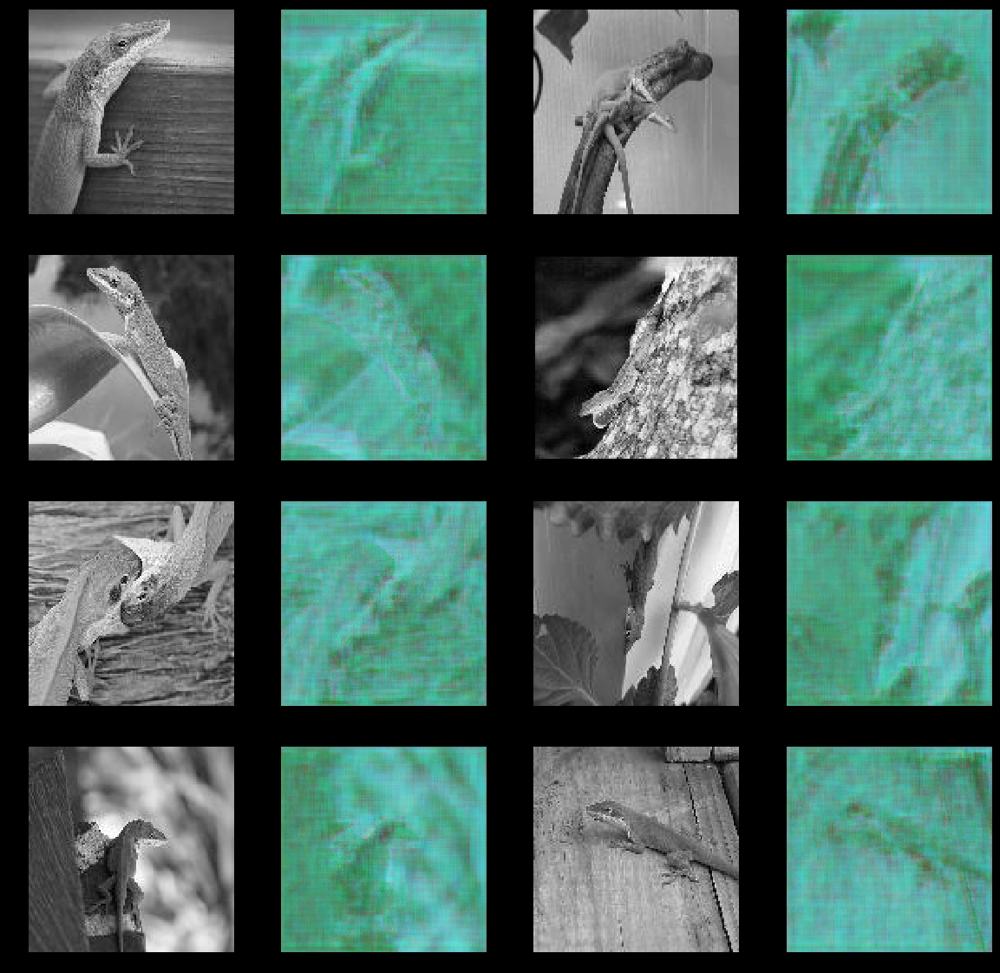

  1%|          | 600/79264 [07:00<14:42:03,  1.49it/s]
WDist -940.3449096679688; GPenalty 2.8067474365234375; RScore 464.88214111328125; FScore -475.4627685546875; GLoss 1565.3292236328125
  1%|          | 700/79264 [08:10<14:38:43,  1.49it/s]
WDist -1087.0858154296875; GPenalty 3.0083796977996826; RScore 538.5244140625; FScore -548.5614013671875; GLoss 1785.09619140625
  1%|          | 800/79264 [09:21<17:52:28,  1.22it/s]
WDist -1240.9779052734375; GPenalty 7.691359043121338; RScore 615.1307983398438; FScore -625.8471069335938; GLoss 1621.46435546875
  1%|          | 900/79264 [10:29<14:36:05,  1.49it/s]
WDist -1397.352783203125; GPenalty 7.342375755310059; RScore 693.2728881835938; FScore -704.079833984375; GLoss 1795.1710205078125
  1%|▏         | 1000/79264 [11:39<14:35:36,  1.49it/s]
WDist -572.74560546875; GPenalty 8.057645797729492; RScore 771.828857421875; FScore 199.08322143554688; GLoss 1683.240478515625


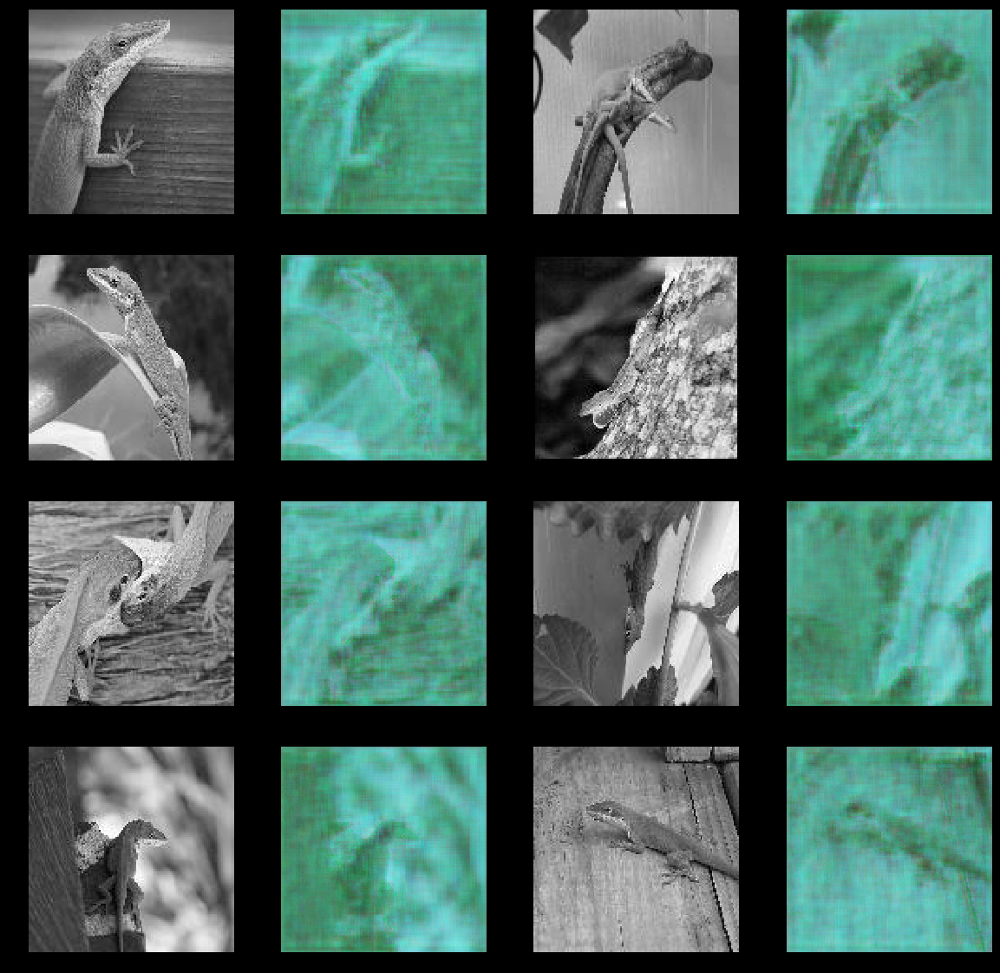

  1%|▏         | 1100/79264 [12:54<14:36:30,  1.49it/s]
WDist -1698.630615234375; GPenalty 6.290950298309326; RScore 843.7975463867188; FScore -854.8330688476562; GLoss 1980.4229736328125
  2%|▏         | 1200/79264 [14:04<14:34:28,  1.49it/s]
WDist -1867.635498046875; GPenalty 6.92426872253418; RScore 928.107177734375; FScore -939.5283813476562; GLoss 1929.2451171875
  2%|▏         | 1300/79264 [15:14<14:36:32,  1.48it/s]
WDist -2035.7540283203125; GPenalty 6.165050983428955; RScore 1011.5992431640625; FScore -1024.15478515625; GLoss 2094.6337890625
  2%|▏         | 1400/79264 [16:22<14:33:16,  1.49it/s]
WDist -2211.4013671875; GPenalty 6.044452667236328; RScore 1099.5565185546875; FScore -1111.8448486328125; GLoss 1903.3663330078125
  2%|▏         | 1500/79264 [17:31<14:32:59,  1.48it/s]
WDist -2389.805908203125; GPenalty 6.665378570556641; RScore 1188.5313720703125; FScore -1201.2745361328125; GLoss 2250.8818359375


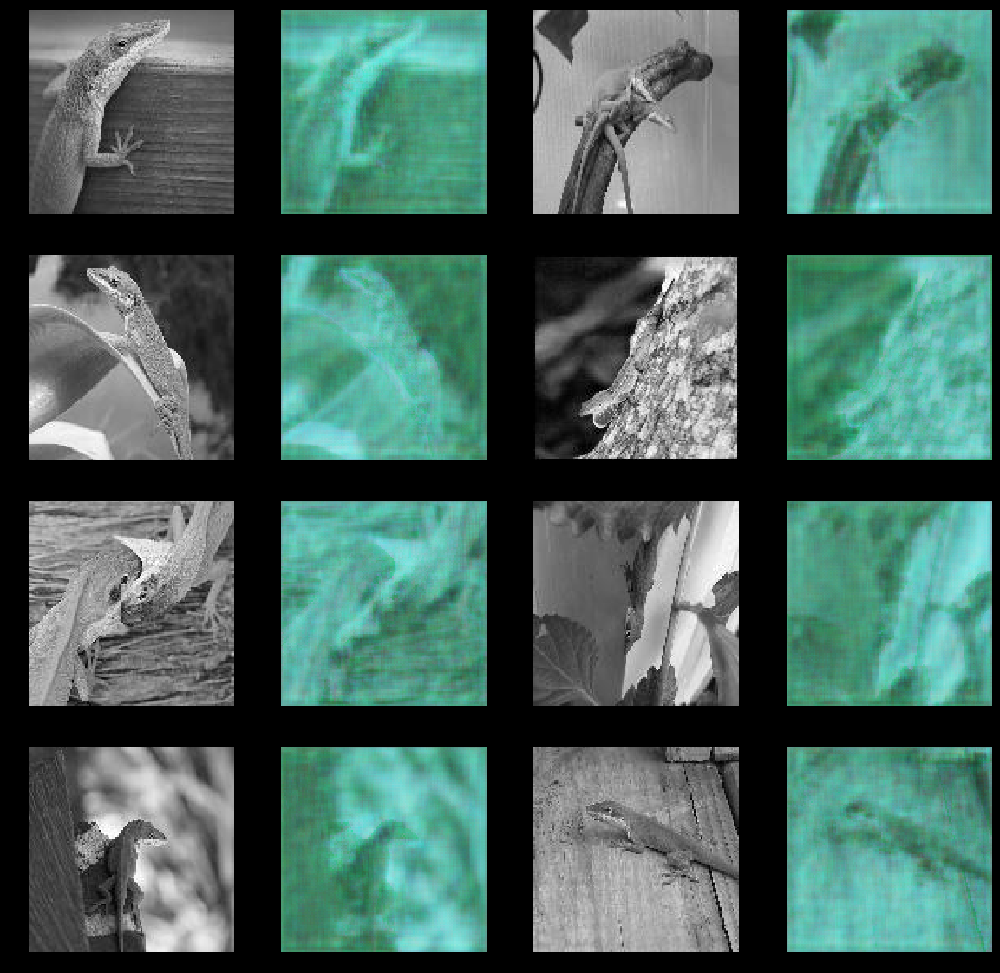

  2%|▏         | 1600/79264 [18:57<14:36:07,  1.48it/s]
WDist -2554.4716796875; GPenalty 1736.614501953125; RScore 1265.0096435546875; FScore -1289.462158203125; GLoss -268.07757568359375
  2%|▏         | 1700/79264 [20:04<14:30:16,  1.49it/s]
WDist -2687.162109375; GPenalty 2.6988987922668457; RScore 1336.5257568359375; FScore -1350.63623046875; GLoss 2405.090576171875
  2%|▏         | 1800/79264 [21:13<14:29:25,  1.48it/s]
WDist -2891.93212890625; GPenalty 6.7108964920043945; RScore 1439.3077392578125; FScore -1452.624267578125; GLoss 2277.587646484375
  2%|▏         | 1900/79264 [22:21<14:29:21,  1.48it/s]
WDist -3084.71923828125; GPenalty 5.934964179992676; RScore 1536.776611328125; FScore -1547.9427490234375; GLoss 2612.6552734375
  3%|▎         | 2000/79264 [23:29<14:27:29,  1.48it/s]
WDist -3283.032958984375; GPenalty 5.753605842590332; RScore 1633.9361572265625; FScore -1649.0968017578125; GLoss 2637.168701171875


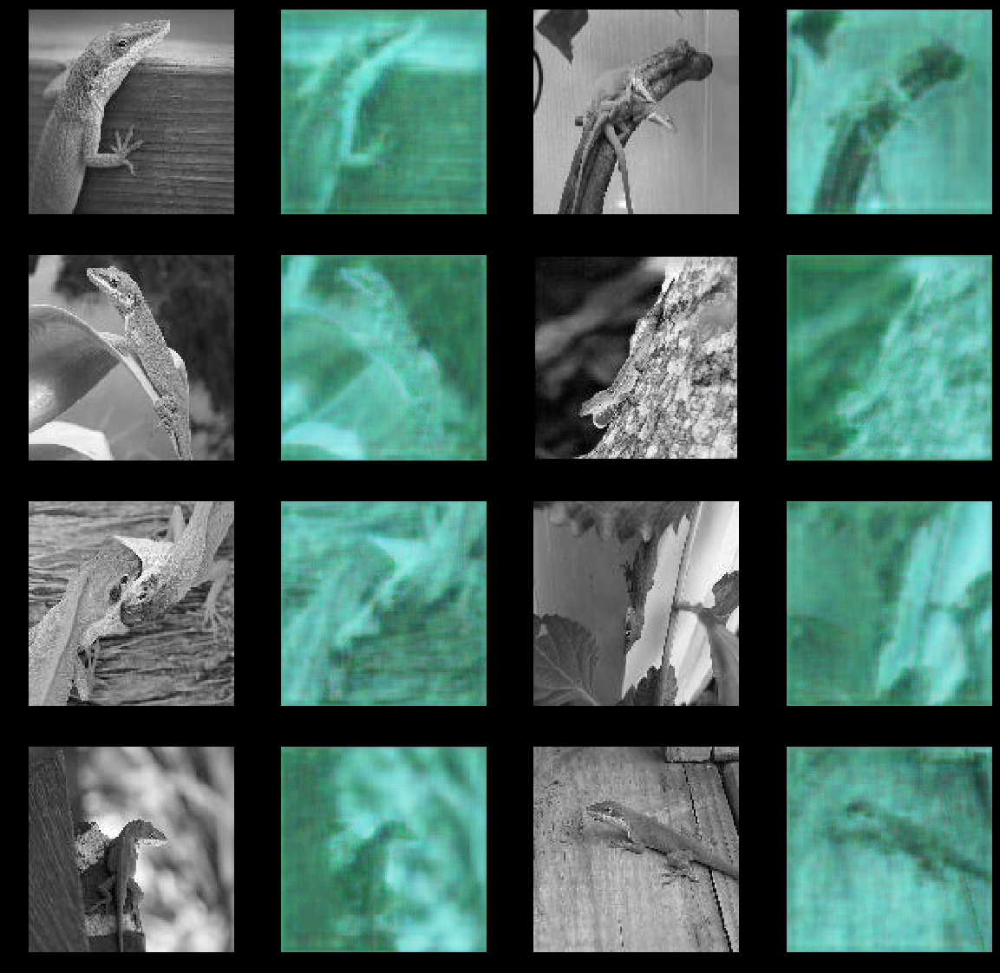

  3%|▎         | 2100/79264 [25:22<14:25:42,  1.49it/s]
WDist -3485.36279296875; GPenalty 3.8849213123321533; RScore 1734.36328125; FScore -1750.9993896484375; GLoss 2868.929931640625
  3%|▎         | 2200/79264 [26:30<14:26:23,  1.48it/s]
WDist -3681.29833984375; GPenalty 2.66827392578125; RScore 1836.1016845703125; FScore -1845.196533203125; GLoss 2761.16064453125
  3%|▎         | 2300/79264 [27:40<14:23:51,  1.48it/s]
WDist -3889.210205078125; GPenalty 3.4918057918548584; RScore 1935.8660888671875; FScore -1953.3441162109375; GLoss 2925.798583984375
  3%|▎         | 2400/79264 [28:50<14:24:34,  1.48it/s]
WDist -4102.6142578125; GPenalty 6.373239040374756; RScore 2042.1868896484375; FScore -2060.427490234375; GLoss 2962.755615234375
  3%|▎         | 2500/79264 [29:57<14:21:36,  1.48it/s]
WDist -4307.74609375; GPenalty 225.8594512939453; RScore 2145.865966796875; FScore -2161.880126953125; GLoss 3062.23681640625


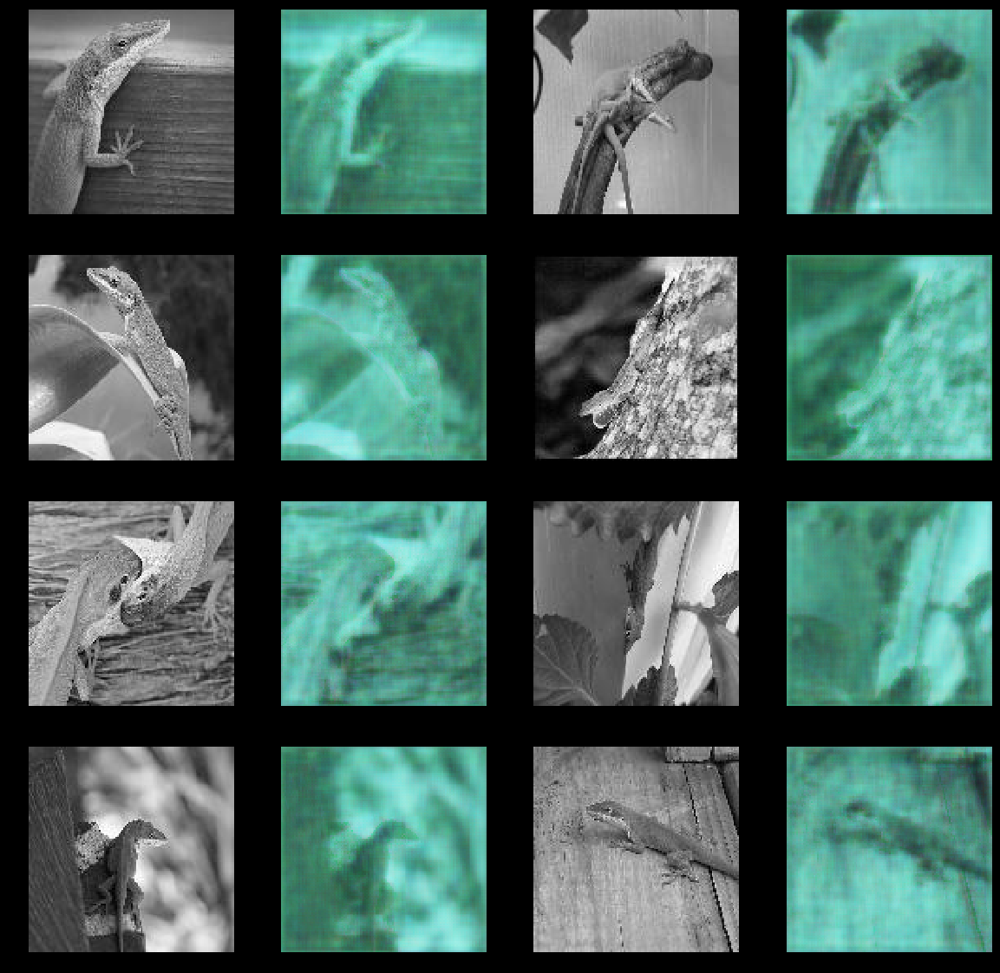

  3%|▎         | 2550/79264 [30:51<14:50:13,  1.44it/s]
WDist -4422.5107421875; GPenalty 5.523962497711182; RScore 2202.134033203125; FScore -2220.376708984375; GLoss 3066.8671875
  3%|▎         | 2600/79264 [31:28<14:47:35,  1.44it/s]
WDist -4531.5419921875; GPenalty 51.885475158691406; RScore 2256.3603515625; FScore -2275.181884765625; GLoss 3180.735107421875
  3%|▎         | 2650/79264 [32:04<14:47:36,  1.44it/s]
WDist -4642.80615234375; GPenalty 6.51452112197876; RScore 2312.421630859375; FScore -2330.384521484375; GLoss 3095.7900390625
  3%|▎         | 2700/79264 [32:42<14:49:03,  1.44it/s]
WDist -4752.83203125; GPenalty 5.6619157791137695; RScore 2366.577880859375; FScore -2386.25439453125; GLoss 3216.4228515625
  3%|▎         | 2750/79264 [33:19<14:47:12,  1.44it/s]
WDist -4426.4619140625; GPenalty 39.9232177734375; RScore 2253.580810546875; FScore -2172.880859375; GLoss 3112.55517578125
  4%|▎         | 2800/79264 [33:56<17:27:48,  1.22it/s]
WDist -3462.4716796875; GPenalty 29.

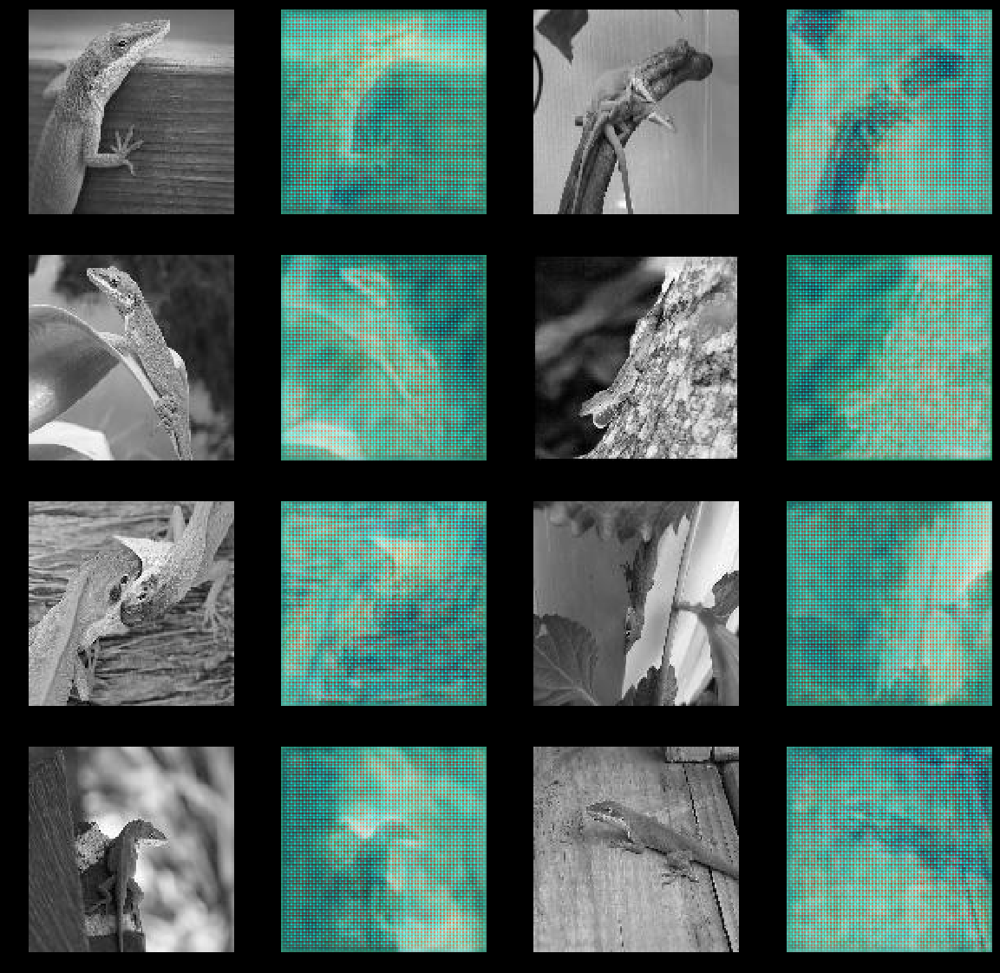

  4%|▍         | 3050/79264 [37:11<14:42:53,  1.44it/s]
WDist -5085.099609375; GPenalty 310.5661315917969; RScore 2540.235595703125; FScore -2544.86376953125; GLoss 3951.001953125
  4%|▍         | 3100/79264 [37:51<14:42:53,  1.44it/s]
WDist -5104.9775390625; GPenalty 309.6914978027344; RScore 2721.404052734375; FScore -2383.5732421875; GLoss 3895.06103515625
  4%|▍         | 3150/79264 [38:27<14:40:46,  1.44it/s]
WDist -5590.75927734375; GPenalty 5.162010669708252; RScore 2791.14697265625; FScore -2799.6123046875; GLoss 4282.3701171875
  4%|▍         | 3200/79264 [39:06<20:05:12,  1.05it/s]
WDist -27.266845703125; GPenalty 9.07690715789795; RScore 2858.5830078125; FScore 2831.316162109375; GLoss -1655.3521728515625
  4%|▍         | 3250/79264 [39:42<14:41:23,  1.44it/s]
WDist -5636.2138671875; GPenalty 1221.3004150390625; RScore 2795.443603515625; FScore -2840.77001953125; GLoss 2239.73876953125
  4%|▍         | 3300/79264 [40:18<14:42:05,  1.44it/s]
WDist -3492.00439453125; GPenalty 

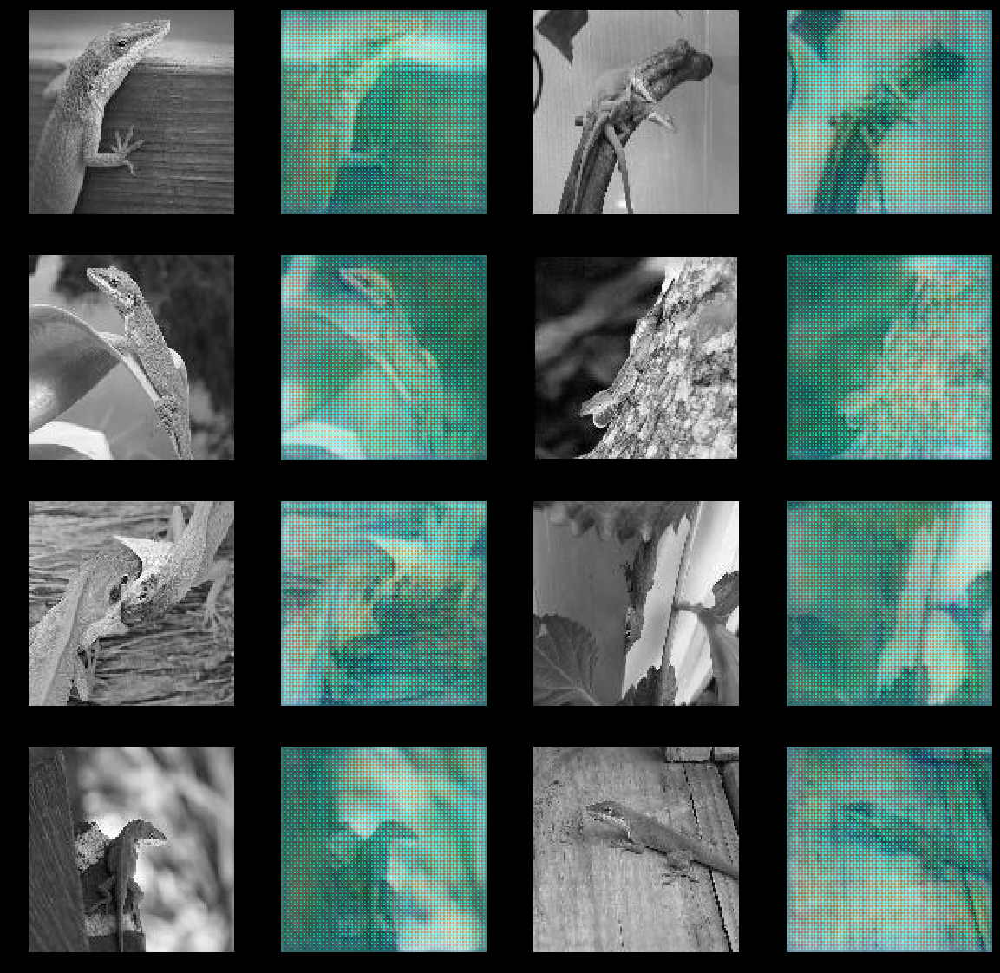

  4%|▍         | 3550/79264 [44:00<14:38:06,  1.44it/s]
WDist -5051.638671875; GPenalty 458.018310546875; RScore 2666.48583984375; FScore -2385.153076171875; GLoss 3533.385498046875
  5%|▍         | 3600/79264 [44:37<17:01:01,  1.24it/s]
WDist -5987.91357421875; GPenalty 470.6292419433594; RScore 2916.15966796875; FScore -3071.75390625; GLoss 3813.05322265625
  5%|▍         | 3650/79264 [45:13<14:37:40,  1.44it/s]
WDist -1284.50244140625; GPenalty 3.923130512237549; RScore 3267.40234375; FScore 1982.89990234375; GLoss 1502.7264404296875
  5%|▍         | 3700/79264 [45:50<14:35:49,  1.44it/s]
WDist -5969.873046875; GPenalty 103.914306640625; RScore 3316.09765625; FScore -2653.775390625; GLoss 4235.53955078125
  5%|▍         | 3750/79264 [46:29<14:38:36,  1.43it/s]
WDist -6874.033203125; GPenalty 11.390748977661133; RScore 3432.743408203125; FScore -3441.289794921875; GLoss 4558.20068359375
  5%|▍         | 3800/79264 [47:05<14:35:15,  1.44it/s]
WDist -6538.0966796875; GPenalty 168.09355

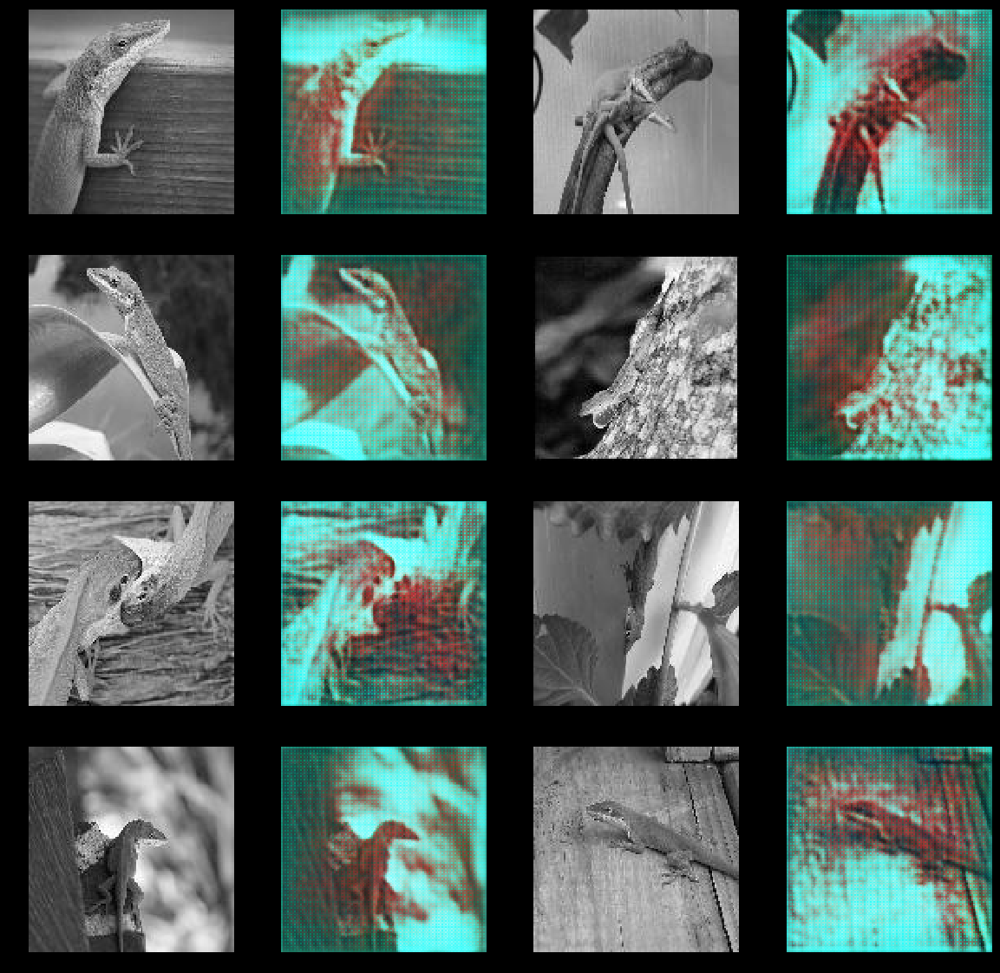

  5%|▌         | 4050/79264 [50:14<14:31:34,  1.44it/s]
WDist -7204.3046875; GPenalty 1365.1483154296875; RScore 3608.654296875; FScore -3595.650146484375; GLoss 2331.447998046875
  5%|▌         | 4100/79264 [50:50<14:30:23,  1.44it/s]
WDist -6742.05859375; GPenalty 555.2527465820312; RScore 3581.36181640625; FScore -3160.697021484375; GLoss 4511.19091796875
  5%|▌         | 4150/79264 [51:28<14:32:25,  1.43it/s]
WDist -7105.6953125; GPenalty 474.89739990234375; RScore 3623.4892578125; FScore -3482.206298828125; GLoss 4667.875
  5%|▌         | 4200/79264 [52:05<14:29:36,  1.44it/s]
WDist -6655.7177734375; GPenalty 256.1187438964844; RScore 3762.525146484375; FScore -2893.192626953125; GLoss 4963.0390625
  5%|▌         | 4250/79264 [52:41<14:31:34,  1.43it/s]
WDist -7329.8974609375; GPenalty 5873.5244140625; RScore 3369.731201171875; FScore -3960.166259765625; GLoss 614.7447509765625
  5%|▌         | 4300/79264 [53:20<14:29:44,  1.44it/s]
WDist -7681.40869140625; GPenalty 1630.760253906

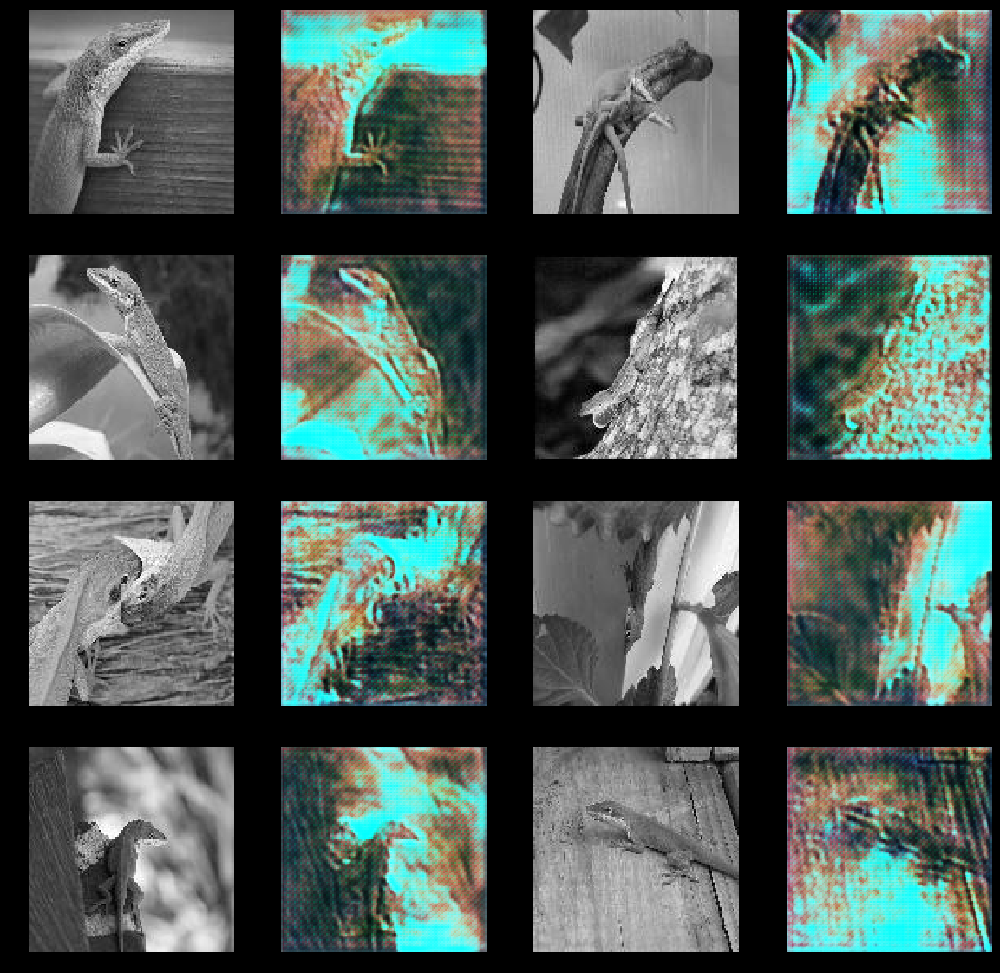

  6%|▌         | 4550/79264 [56:53<14:28:30,  1.43it/s]
WDist -6988.76416015625; GPenalty 1055.090576171875; RScore 2884.45166015625; FScore -4104.3125; GLoss 4086.6630859375
  6%|▌         | 4600/79264 [57:30<14:23:42,  1.44it/s]
WDist -1865.175048828125; GPenalty 56.226654052734375; RScore 3452.58251953125; FScore 1587.407470703125; GLoss -403.38543701171875
  6%|▌         | 4650/79264 [58:06<14:24:01,  1.44it/s]
WDist -6827.421875; GPenalty 84.18495178222656; RScore 4241.443359375; FScore -2585.978759765625; GLoss 5249.33544921875
  6%|▌         | 4700/79264 [58:43<14:22:54,  1.44it/s]
WDist -7290.45703125; GPenalty 913.919677734375; RScore 3961.4150390625; FScore -3329.041748046875; GLoss 4949.861328125
  6%|▌         | 4750/79264 [59:19<14:24:24,  1.44it/s]
WDist -7828.8916015625; GPenalty 202.16314697265625; RScore 3781.1689453125; FScore -4047.72265625; GLoss 4865.89892578125
  6%|▌         | 4800/79264 [59:58<20:01:21,  1.03it/s]
WDist -2091.459228515625; GPenalty 155.782974243

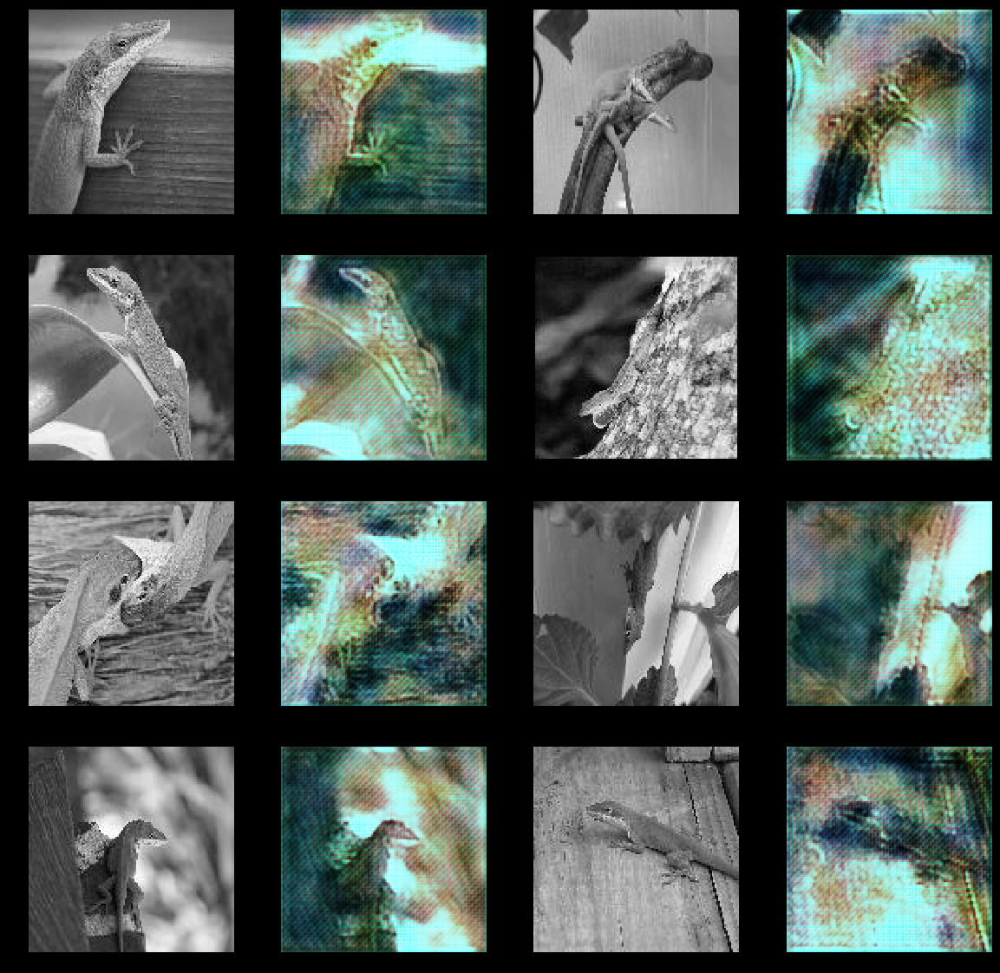

  6%|▋         | 5050/79264 [1:03:11<14:19:15,  1.44it/s]
WDist -8765.0283203125; GPenalty 11520.904296875; RScore 4006.005126953125; FScore -4759.0234375; GLoss -3530.90087890625
  6%|▋         | 5100/79264 [1:03:49<14:20:01,  1.44it/s]
WDist -1839.877197265625; GPenalty 109.78431701660156; RScore 4600.1728515625; FScore 2760.295654296875; GLoss -1710.417236328125
  6%|▋         | 5150/79264 [1:04:25<14:19:33,  1.44it/s]
WDist -7521.337890625; GPenalty 1233.893310546875; RScore 4147.388671875; FScore -3373.948974609375; GLoss 4979.09716796875
  7%|▋         | 5200/79264 [1:05:01<14:20:35,  1.43it/s]
WDist -7297.0048828125; GPenalty 1196.6517333984375; RScore 4443.05419921875; FScore -2853.950439453125; GLoss 4050.77978515625
  7%|▋         | 5250/79264 [1:05:40<14:18:17,  1.44it/s]
WDist -9442.408203125; GPenalty 3416.99951171875; RScore 4610.43212890625; FScore -4831.9765625; GLoss 3578.09228515625
  7%|▋         | 5300/79264 [1:06:16<14:16:35,  1.44it/s]
WDist -5409.62255859375; GPe

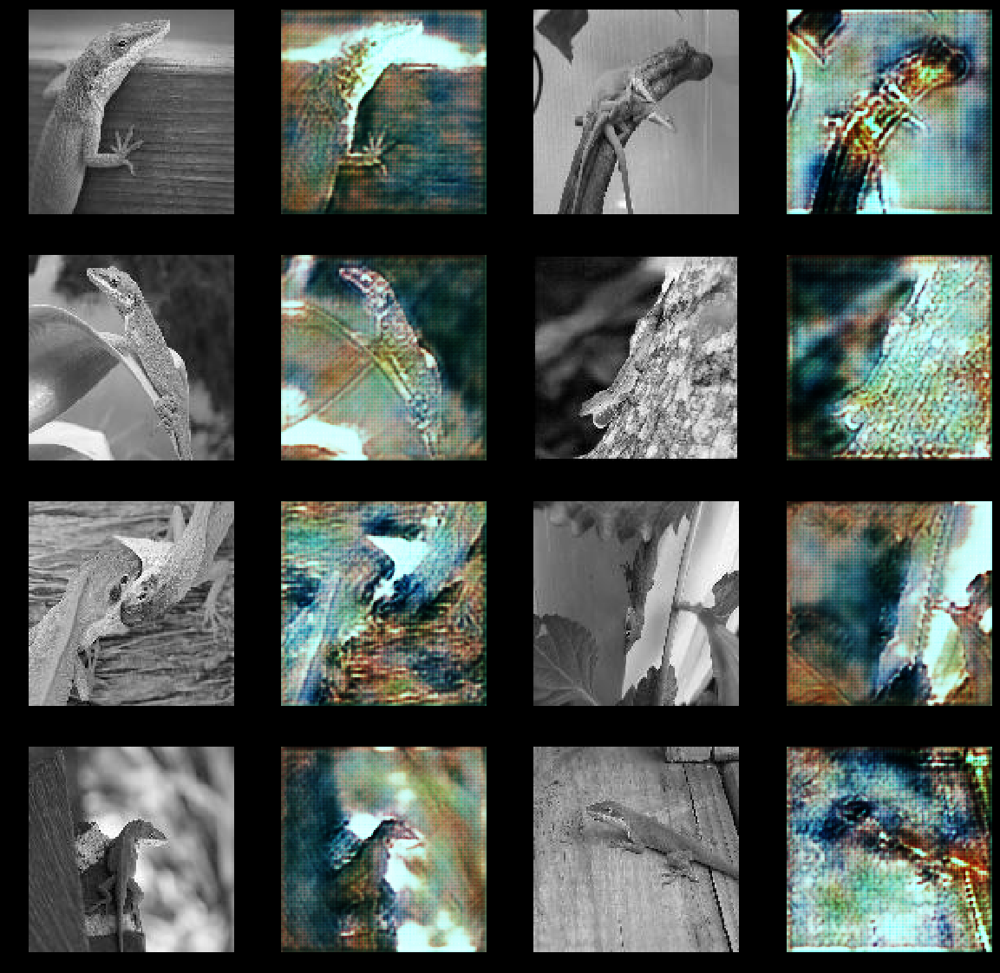

  7%|▋         | 5550/79264 [1:10:18<14:14:50,  1.44it/s]
WDist -5636.28955078125; GPenalty 1928.6436767578125; RScore 2099.79638671875; FScore -3536.4931640625; GLoss 4177.828125
  7%|▋         | 5600/79264 [1:10:54<14:13:23,  1.44it/s]
WDist -5876.8583984375; GPenalty 2135.23974609375; RScore 2236.156982421875; FScore -3640.701416015625; GLoss 3494.054443359375
  7%|▋         | 5650/79264 [1:11:33<14:15:43,  1.43it/s]
WDist -7077.6572265625; GPenalty 2368.523193359375; RScore 3496.56640625; FScore -3581.091064453125; GLoss 5285.68017578125
  7%|▋         | 5700/79264 [1:12:09<14:12:24,  1.44it/s]
WDist -6592.8623046875; GPenalty 2439.616455078125; RScore 3363.54736328125; FScore -3229.314697265625; GLoss 5965.3291015625
  7%|▋         | 5750/79264 [1:12:48<17:58:04,  1.14it/s]
WDist -7964.998046875; GPenalty 3466.08935546875; RScore 4051.13232421875; FScore -3913.86572265625; GLoss 5859.7255859375
  7%|▋         | 5800/79264 [1:13:24<14:11:39,  1.44it/s]
WDist -6676.03271484375; GPen

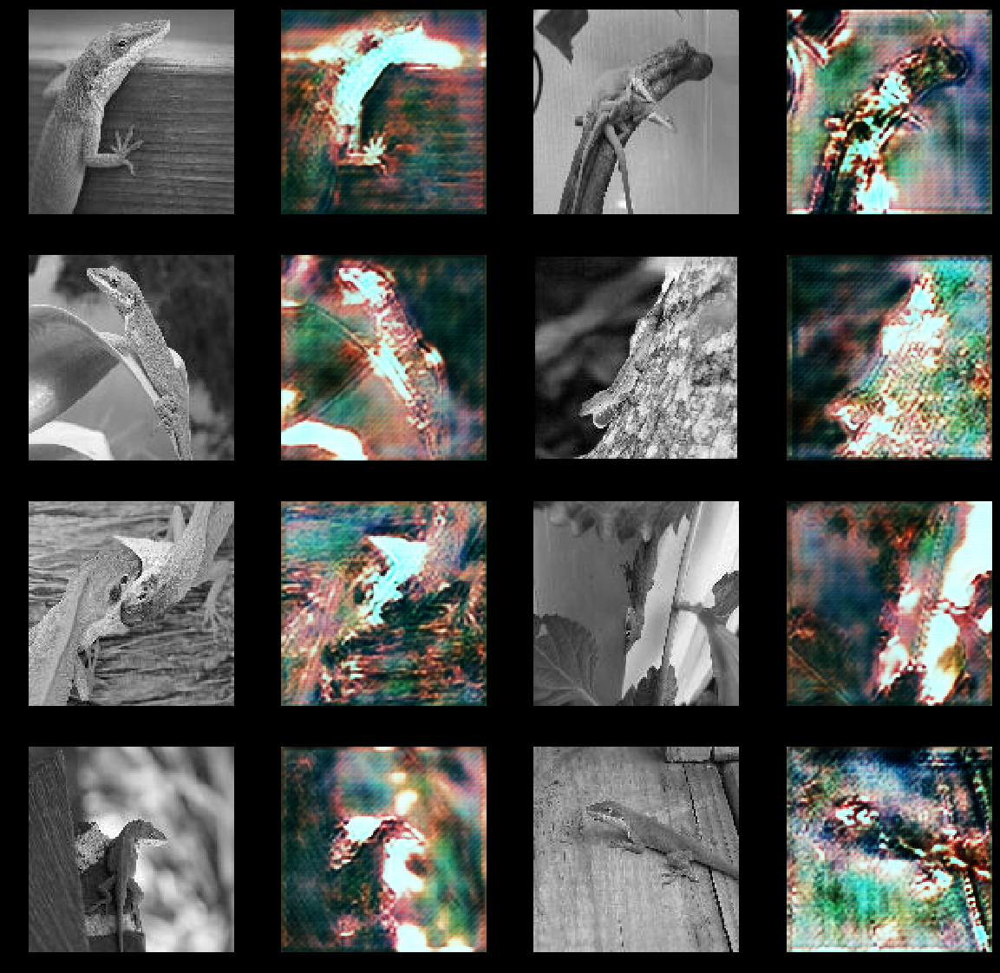

  8%|▊         | 6050/79264 [1:17:17<14:07:25,  1.44it/s]
WDist -6029.1357421875; GPenalty 3234.5673828125; RScore 1188.239990234375; FScore -4840.89599609375; GLoss 6058.10546875
  8%|▊         | 6100/79264 [1:17:53<14:06:54,  1.44it/s]
WDist -4677.72265625; GPenalty 1046.7078857421875; RScore -770.39306640625; FScore -5448.11572265625; GLoss 5379.802734375
  8%|▊         | 6150/79264 [1:18:36<23:02:36,  1.13s/it]
WDist -7575.68359375; GPenalty 2225.593017578125; RScore 2852.80712890625; FScore -4722.87646484375; GLoss 5832.5302734375
  8%|▊         | 6200/79264 [1:19:12<14:06:10,  1.44it/s]
WDist -4159.1650390625; GPenalty 1151.00732421875; RScore -1332.64453125; FScore -5491.8095703125; GLoss 4576.42138671875
  8%|▊         | 6250/79264 [1:19:48<14:05:39,  1.44it/s]
WDist -8263.2919921875; GPenalty 4257.6767578125; RScore 3753.475341796875; FScore -4509.81640625; GLoss 5655.689453125
  8%|▊         | 6300/79264 [1:20:27<14:08:35,  1.43it/s]
WDist -5819.763671875; GPenalty 2637.47558

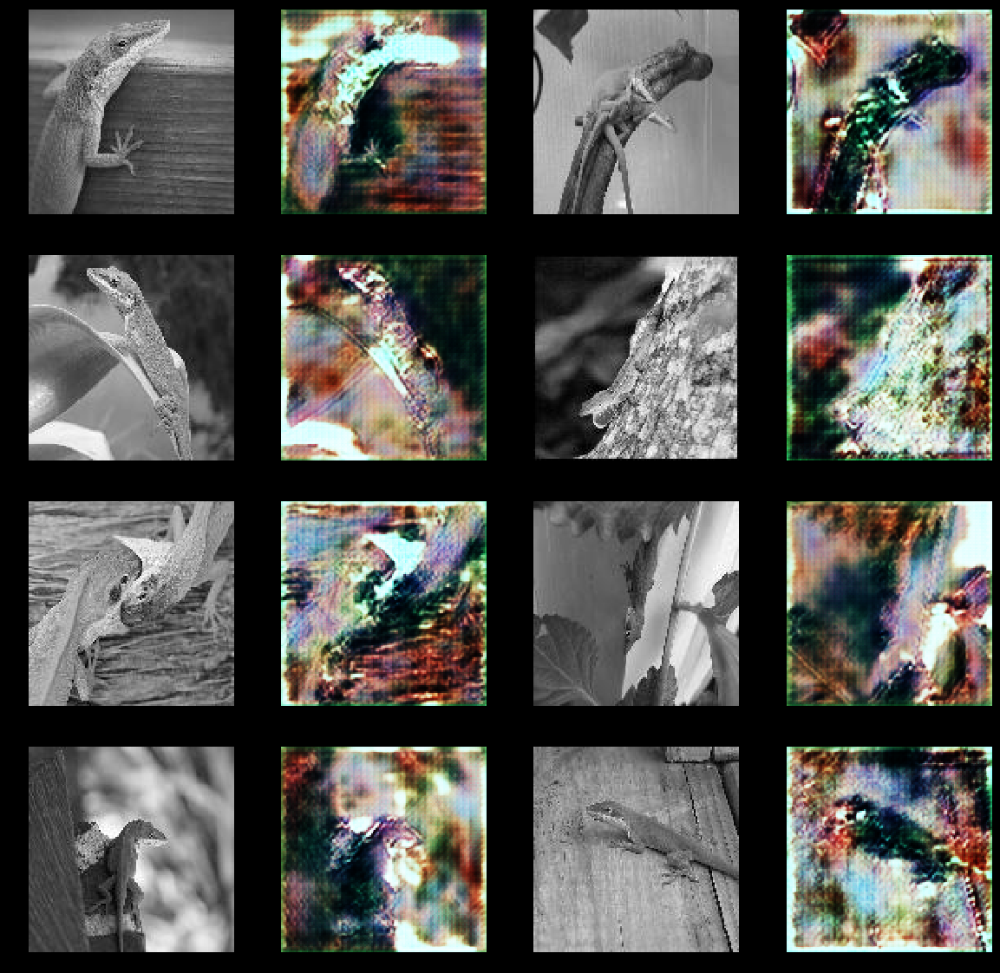

  8%|▊         | 6550/79264 [1:23:42<20:29:31,  1.01s/it]
WDist -6990.3193359375; GPenalty 1147.1842041015625; RScore 1007.1348266601562; FScore -5983.1845703125; GLoss 6586.06884765625
  8%|▊         | 6600/79264 [1:24:18<14:03:34,  1.44it/s]
WDist -5915.26611328125; GPenalty 1076.0859375; RScore 140.27456665039062; FScore -5774.99169921875; GLoss 5671.93408203125
  8%|▊         | 6650/79264 [1:24:54<14:02:47,  1.44it/s]
WDist -7988.7548828125; GPenalty 1674.92822265625; RScore 2298.184814453125; FScore -5690.56982421875; GLoss 6454.83935546875
  8%|▊         | 6700/79264 [1:25:36<14:00:28,  1.44it/s]
WDist -8828.017578125; GPenalty 3097.57373046875; RScore 3663.1181640625; FScore -5164.89892578125; GLoss 6802.08154296875
  9%|▊         | 6750/79264 [1:26:12<14:00:18,  1.44it/s]
WDist -7076.6318359375; GPenalty 2102.83349609375; RScore 2039.0145263671875; FScore -5037.6171875; GLoss 6346.626953125
  9%|▊         | 6800/79264 [1:26:48<14:00:01,  1.44it/s]
WDist -6589.2890625; GPenalty 

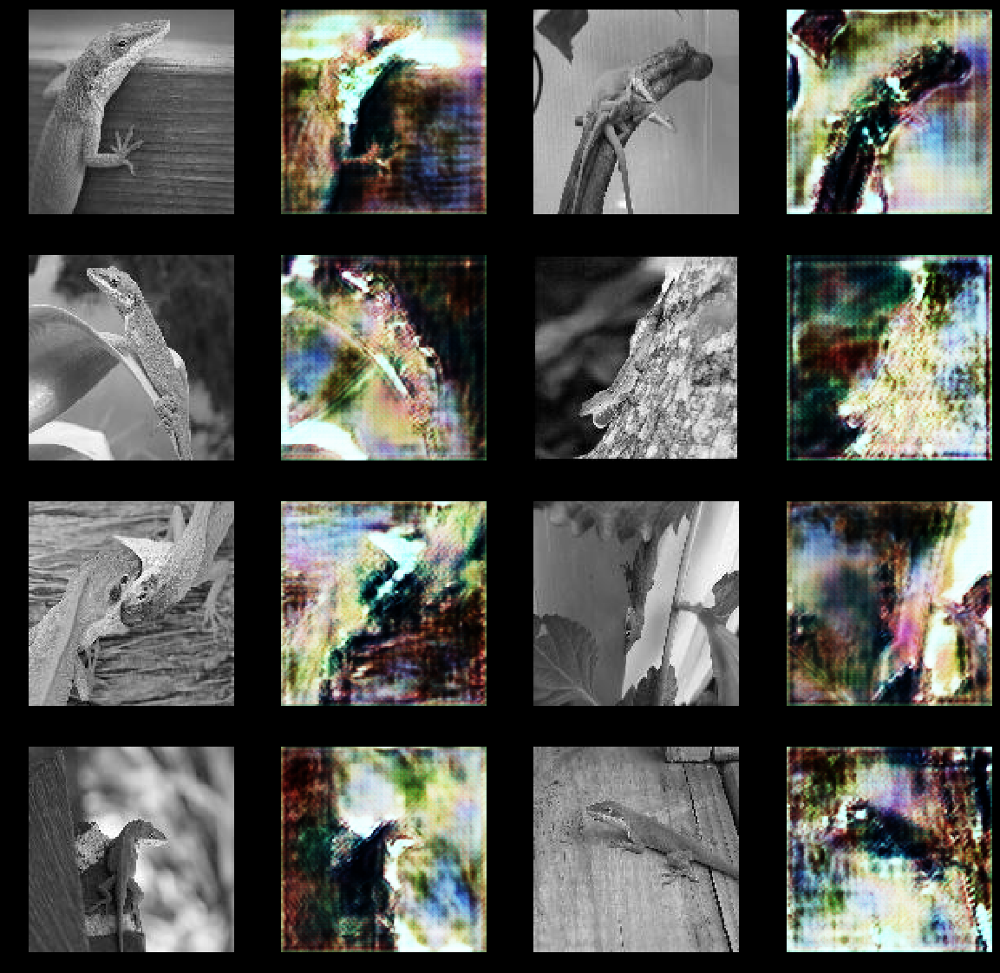

  9%|▉         | 7050/79264 [1:30:29<13:56:21,  1.44it/s]
WDist -5219.3115234375; GPenalty 806.6373291015625; RScore 1670.1937255859375; FScore -3549.11767578125; GLoss 5045.6162109375
  9%|▉         | 7100/79264 [1:31:09<13:59:28,  1.43it/s]
WDist -7724.8291015625; GPenalty 2507.940673828125; RScore 2562.83349609375; FScore -5161.99560546875; GLoss 7297.6611328125
  9%|▉         | 7150/79264 [1:31:45<13:55:59,  1.44it/s]
WDist -7165.08056640625; GPenalty 1555.2930908203125; RScore 1279.8260498046875; FScore -5885.25439453125; GLoss 6290.66796875
  9%|▉         | 7200/79264 [1:32:22<13:52:50,  1.44it/s]
WDist -9365.30078125; GPenalty 4028.5009765625; RScore 3343.472900390625; FScore -6021.828125; GLoss 7575.52734375
  9%|▉         | 7250/79264 [1:33:01<13:54:01,  1.44it/s]
WDist -5194.03515625; GPenalty 3700.4091796875; RScore 1689.66162109375; FScore -3504.373779296875; GLoss 8099.09912109375
  9%|▉         | 7300/79264 [1:33:37<13:52:24,  1.44it/s]
WDist -6371.1474609375; GPenalty 19

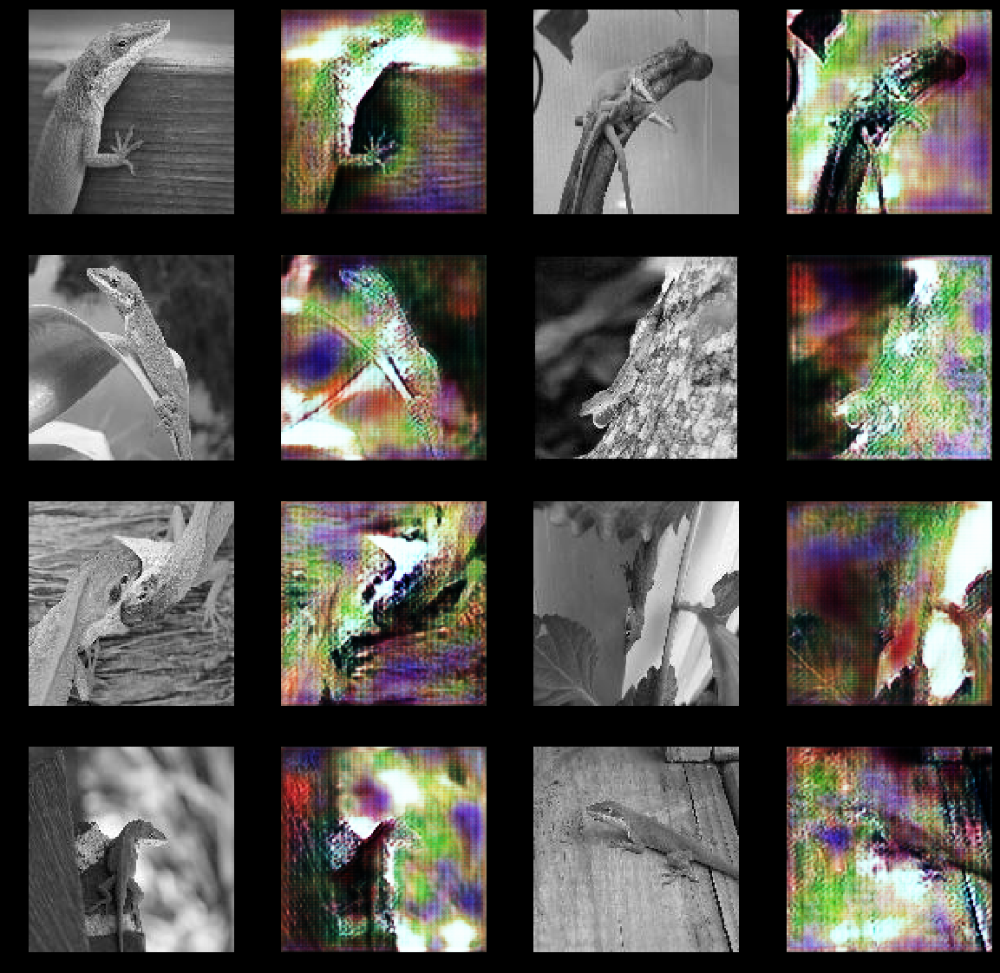

 10%|█         | 8050/79264 [1:42:54<13:45:24,  1.44it/s]
WDist -9456.49609375; GPenalty 3582.890380859375; RScore 2856.64404296875; FScore -6599.85205078125; GLoss 7398.91064453125
 10%|█         | 8100/79264 [1:43:30<13:44:07,  1.44it/s]
WDist -4651.7216796875; GPenalty 1111.7080078125; RScore 599.1898193359375; FScore -4052.53173828125; GLoss 4955.28515625
 10%|█         | 8150/79264 [1:44:06<13:43:53,  1.44it/s]
WDist -5102.75390625; GPenalty 1742.05126953125; RScore 1225.74609375; FScore -3877.0078125; GLoss 6480.68603515625
 10%|█         | 8200/79264 [1:44:44<13:42:20,  1.44it/s]
WDist -12865.65625; GPenalty 3865.77490234375; RScore 5784.41650390625; FScore -7081.2392578125; GLoss 8647.4755859375
 10%|█         | 8250/79264 [1:45:20<13:43:41,  1.44it/s]
WDist -4415.99609375; GPenalty 464.7066650390625; RScore -3413.225341796875; FScore -7829.2216796875; GLoss 8568.720703125
 10%|█         | 8300/79264 [1:45:59<17:11:25,  1.15it/s]
WDist -8788.2431640625; GPenalty 2729.830078125;

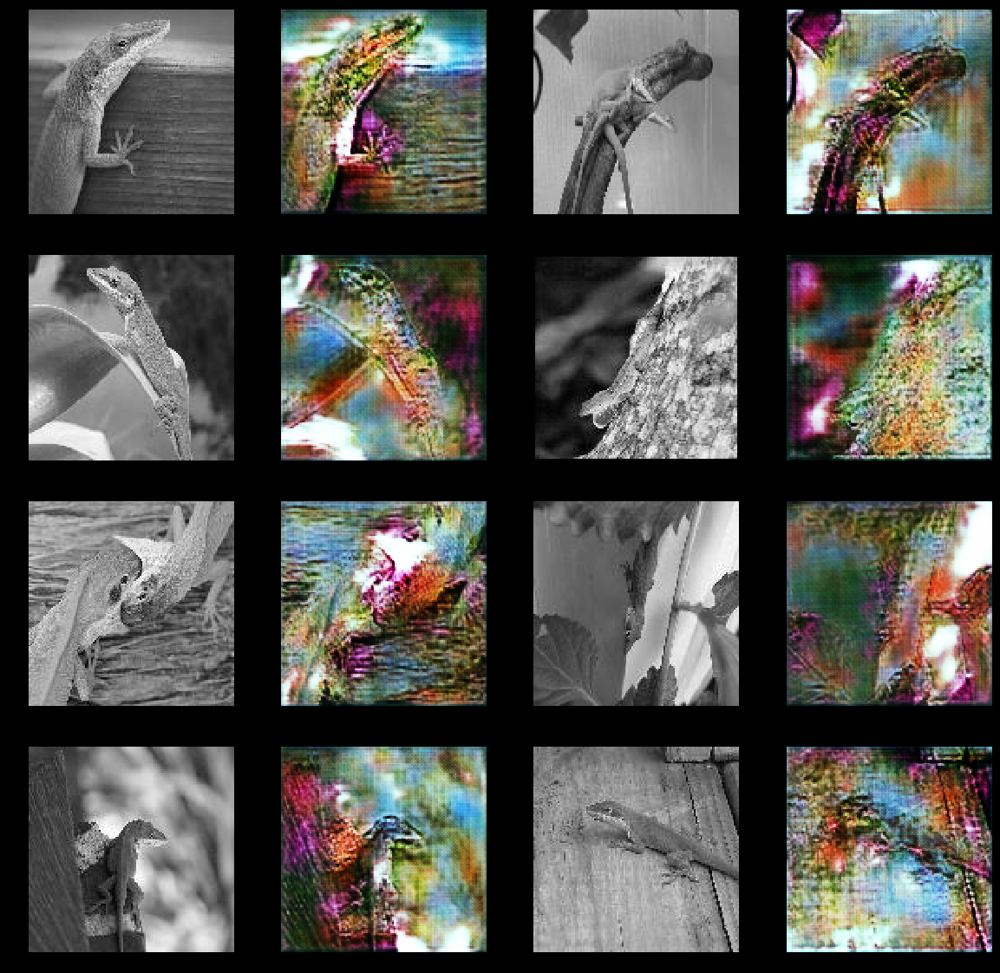

 11%|█         | 8550/79264 [1:49:42<13:39:03,  1.44it/s]
WDist -7651.12548828125; GPenalty 1781.98974609375; RScore 200.33290100097656; FScore -7450.79248046875; GLoss 5892.24169921875
 11%|█         | 8600/79264 [1:50:21<13:36:42,  1.44it/s]
WDist -7196.9306640625; GPenalty 1228.6378173828125; RScore 1681.64697265625; FScore -5515.28369140625; GLoss 7521.7236328125
 11%|█         | 8650/79264 [1:50:58<13:39:14,  1.44it/s]
WDist -9833.10546875; GPenalty 3467.291259765625; RScore 3726.727294921875; FScore -6106.3779296875; GLoss 7723.8291015625
 11%|█         | 8700/79264 [1:51:35<15:16:00,  1.28it/s]
WDist -11940.140625; GPenalty 2411.179931640625; RScore 4848.74462890625; FScore -7091.39599609375; GLoss 8783.853515625
 11%|█         | 8750/79264 [1:52:11<13:38:34,  1.44it/s]
WDist -6502.6337890625; GPenalty 2555.7099609375; RScore -1314.540283203125; FScore -7817.17431640625; GLoss 8129.09228515625
 11%|█         | 8800/79264 [1:52:47<13:36:21,  1.44it/s]
WDist -9504.767578125; GPena

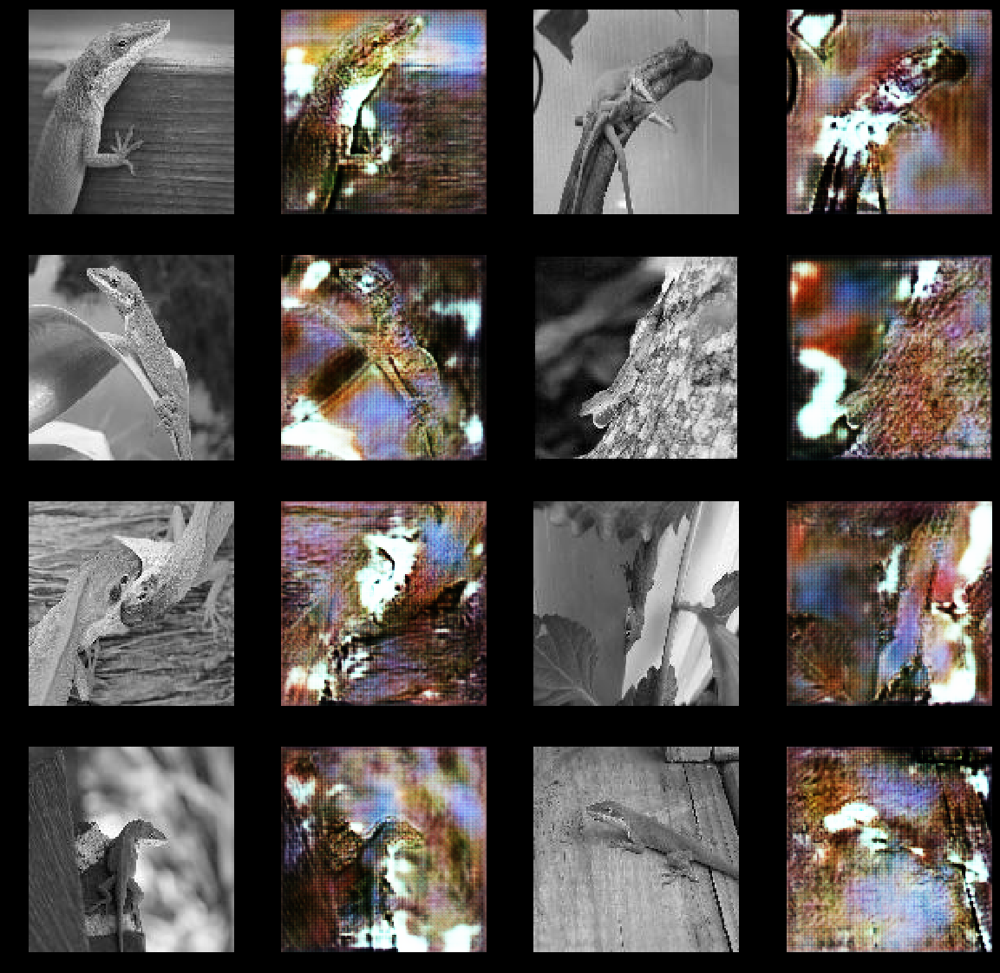

 11%|█▏        | 9050/79264 [1:56:35<13:32:17,  1.44it/s]
WDist -4179.9033203125; GPenalty 830.7327270507812; RScore -3815.192138671875; FScore -7995.095703125; GLoss 7632.859375
 11%|█▏        | 9100/79264 [1:57:15<19:22:40,  1.01it/s]
WDist -6319.78662109375; GPenalty 1256.769287109375; RScore -1067.4696044921875; FScore -7387.25634765625; GLoss 6495.6904296875
 12%|█▏        | 9150/79264 [1:57:51<13:31:15,  1.44it/s]
WDist -5923.0458984375; GPenalty 2438.84326171875; RScore 1607.710693359375; FScore -4315.33544921875; GLoss 7195.37451171875
 12%|█▏        | 9200/79264 [1:58:27<13:31:06,  1.44it/s]
WDist -6650.20556640625; GPenalty 1130.001220703125; RScore -410.9753112792969; FScore -7061.1806640625; GLoss 7484.31103515625
 12%|█▏        | 9250/79264 [1:59:05<13:32:14,  1.44it/s]
WDist -5150.8564453125; GPenalty 894.0035400390625; RScore -3176.38671875; FScore -8327.2431640625; GLoss 8506.8671875
 12%|█▏        | 9300/79264 [1:59:41<13:30:55,  1.44it/s]
WDist -8071.54638671875; GPen

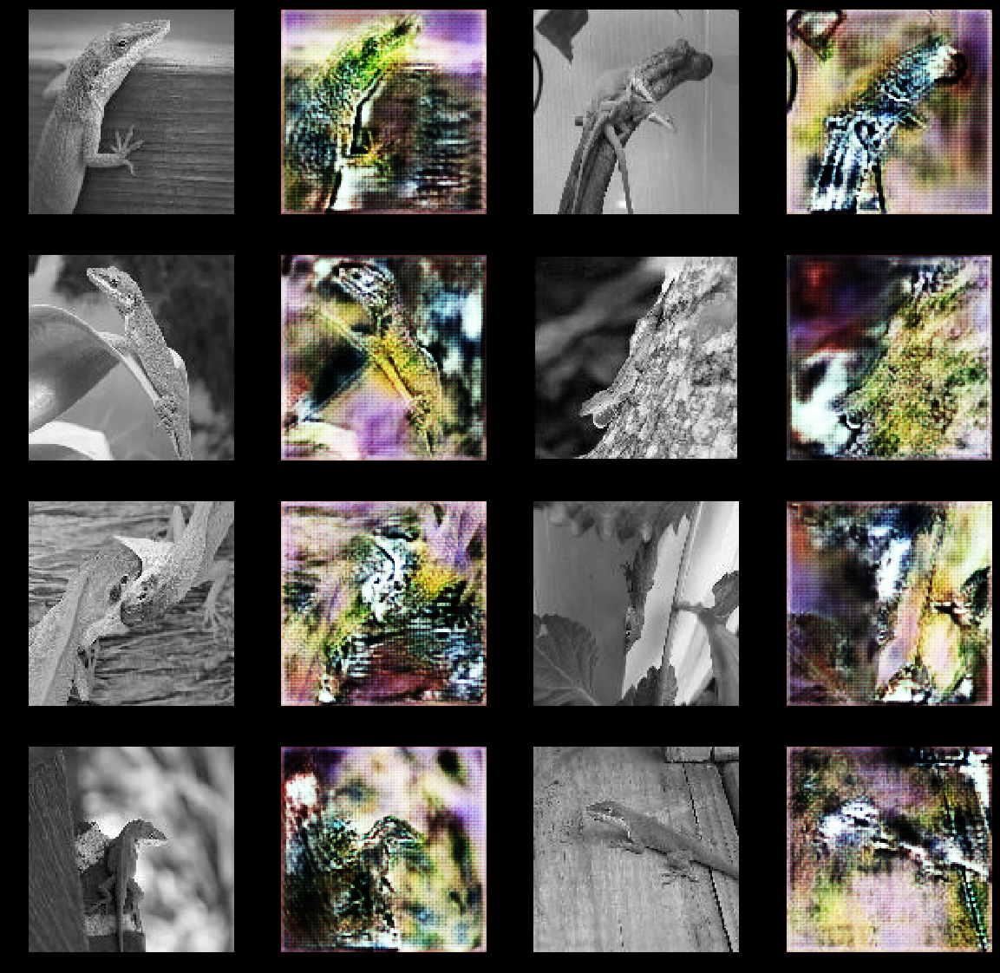

 12%|█▏        | 9550/79264 [2:02:59<13:26:55,  1.44it/s]
WDist -6180.626953125; GPenalty 1104.0758056640625; RScore -1934.68310546875; FScore -8115.31005859375; GLoss 8332.8505859375
 12%|█▏        | 9600/79264 [2:03:35<13:26:49,  1.44it/s]
WDist -10922.63671875; GPenalty 4185.37744140625; RScore 2614.16064453125; FScore -8308.4765625; GLoss 10215.181640625
 12%|█▏        | 9650/79264 [2:04:13<13:26:02,  1.44it/s]
WDist -11563.283203125; GPenalty 1159.4508056640625; RScore 3863.09912109375; FScore -7700.1845703125; GLoss 8691.5302734375
 12%|█▏        | 9700/79264 [2:04:49<13:25:00,  1.44it/s]
WDist -13289.57421875; GPenalty 4482.9794921875; RScore 5658.501953125; FScore -7631.07275390625; GLoss 9947.0966796875
 12%|█▏        | 9750/79264 [2:05:25<13:24:17,  1.44it/s]
WDist -2004.34423828125; GPenalty 531.2068481445312; RScore -2300.39306640625; FScore -4304.7373046875; GLoss 6401.3828125
 12%|█▏        | 9800/79264 [2:06:03<13:23:47,  1.44it/s]
WDist -6200.15771484375; GPenalty 1129.

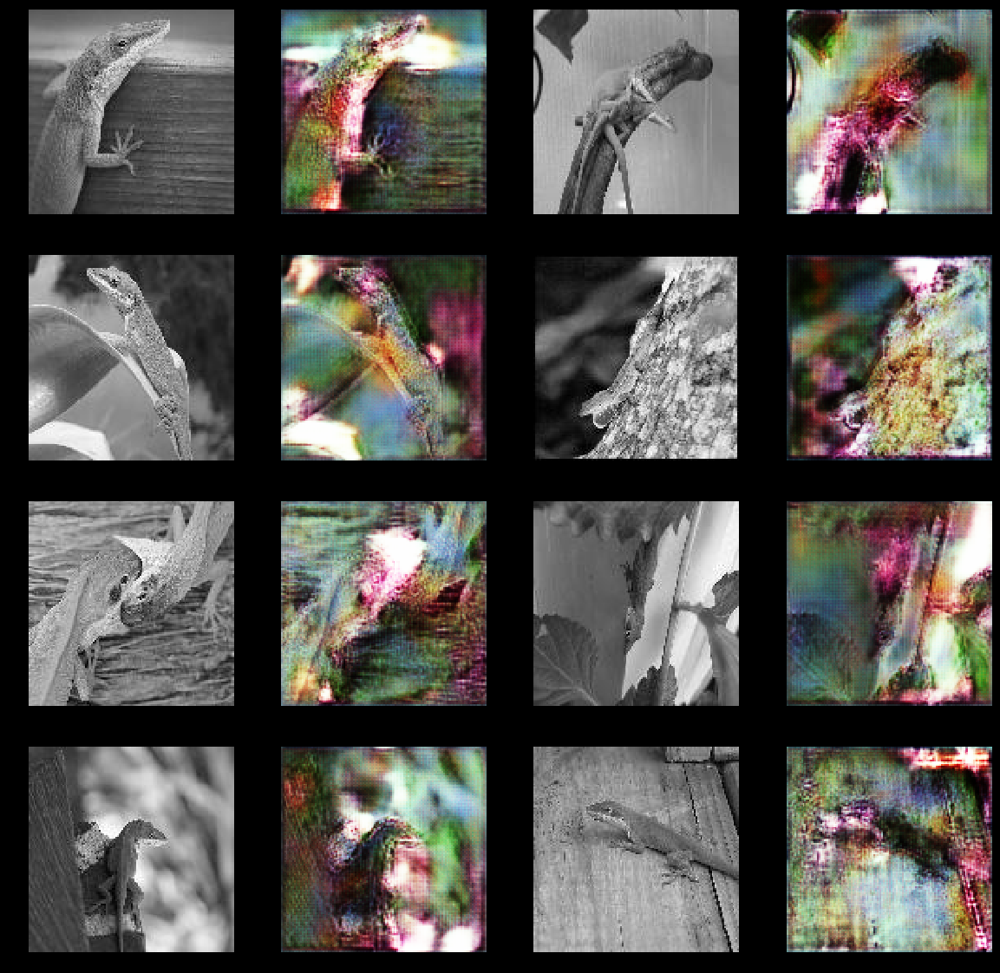

 13%|█▎        | 10050/79264 [2:09:26<13:21:02,  1.44it/s]
WDist -15032.1640625; GPenalty 5769.9208984375; RScore 6223.14990234375; FScore -8809.013671875; GLoss 10664.771484375
 13%|█▎        | 10200/79264 [2:11:12<13:20:57,  1.44it/s]
WDist -6249.4296875; GPenalty 1104.1724853515625; RScore -2246.869384765625; FScore -8496.298828125; GLoss 9766.994140625
 13%|█▎        | 10250/79264 [2:11:48<13:18:32,  1.44it/s]
WDist -11258.1923828125; GPenalty 1290.4140625; RScore 1811.140380859375; FScore -9447.0517578125; GLoss 9012.2998046875
 13%|█▎        | 10300/79264 [2:12:24<13:19:24,  1.44it/s]
WDist -6037.41162109375; GPenalty 829.898681640625; RScore -2114.068359375; FScore -8151.47998046875; GLoss 7953.32666015625
 13%|█▎        | 10350/79264 [2:13:03<13:20:04,  1.44it/s]
WDist -8943.3828125; GPenalty 1866.3798828125; RScore -603.7586059570312; FScore -9547.1416015625; GLoss 4949.4443359375
 13%|█▎        | 10400/79264 [2:13:40<13:16:27,  1.44it/s]
WDist -8051.0791015625; GPenalty 2465.

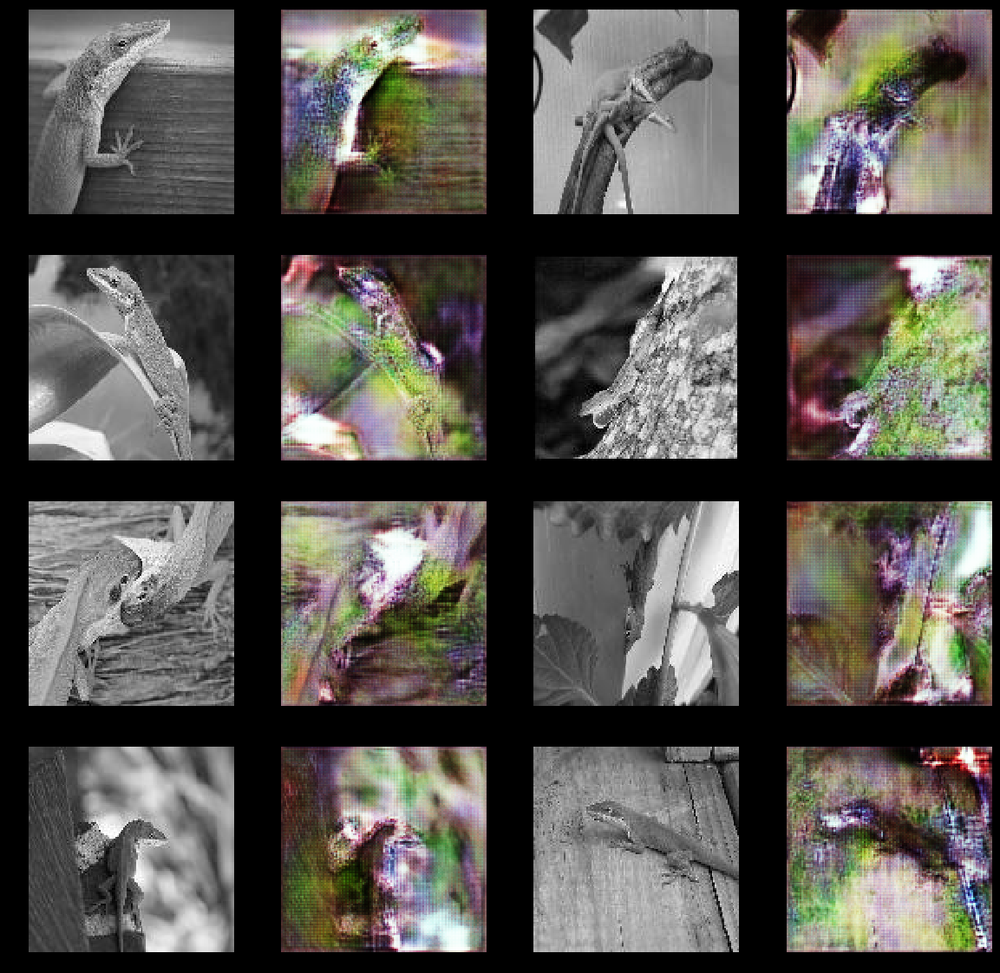

 13%|█▎        | 10550/79264 [2:16:00<13:14:38,  1.44it/s]
WDist -14332.75390625; GPenalty 5588.95556640625; RScore 5038.30126953125; FScore -9294.4521484375; GLoss 10944.72265625
 13%|█▎        | 10600/79264 [2:16:38<13:15:56,  1.44it/s]
WDist -7443.4755859375; GPenalty 1338.855224609375; RScore -1053.099609375; FScore -8496.5751953125; GLoss 9111.1240234375
 13%|█▎        | 10650/79264 [2:17:15<13:14:29,  1.44it/s]
WDist -11366.884765625; GPenalty 1658.026123046875; RScore 2791.9892578125; FScore -8574.8955078125; GLoss 10856.06640625
 13%|█▎        | 10700/79264 [2:17:51<13:13:05,  1.44it/s]
WDist -10906.5888671875; GPenalty 1958.816650390625; RScore 3521.175048828125; FScore -7385.41357421875; GLoss 10687.8427734375
 14%|█▎        | 10750/79264 [2:18:30<13:12:25,  1.44it/s]
WDist -11444.146484375; GPenalty 6685.50732421875; RScore 5469.0888671875; FScore -5975.0576171875; GLoss 11433.03125
 14%|█▎        | 10800/79264 [2:19:06<13:09:25,  1.45it/s]
WDist -8230.5419921875; GPenalty 2

/home/jason/anaconda3/envs/fastai/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


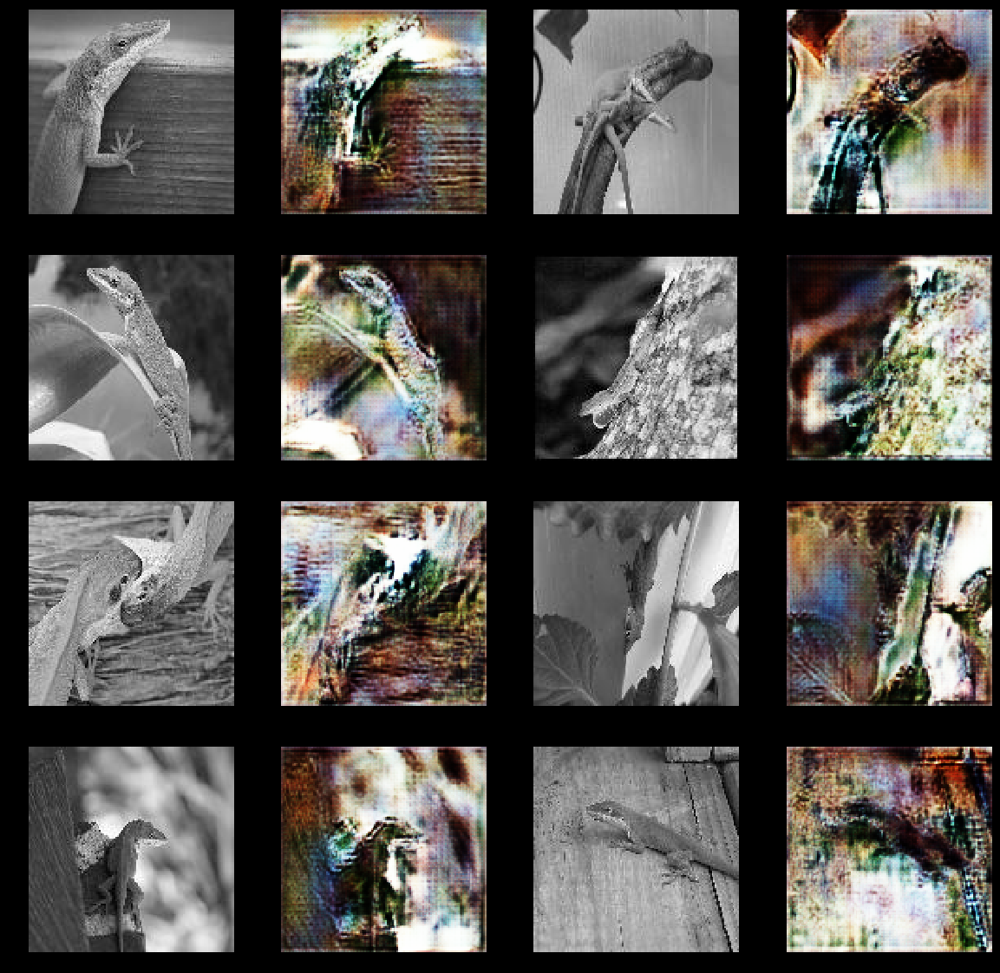

 14%|█▍        | 11050/79264 [2:22:41<13:09:44,  1.44it/s]
WDist -15131.80078125; GPenalty 3814.341796875; RScore 6095.9140625; FScore -9035.88671875; GLoss 10899.6787109375
 14%|█▍        | 11100/79264 [2:23:17<13:09:01,  1.44it/s]
WDist -15364.46484375; GPenalty 2123.811767578125; RScore 5509.0439453125; FScore -9855.4208984375; GLoss 11380.1875
 14%|█▍        | 11150/79264 [2:23:56<13:09:00,  1.44it/s]
WDist -1348.7685546875; GPenalty 246.05377197265625; RScore -8304.837890625; FScore -9653.6064453125; GLoss 10973.796875
 14%|█▍        | 11200/79264 [2:24:33<13:07:54,  1.44it/s]
WDist -8614.6083984375; GPenalty 3352.663818359375; RScore 4171.830078125; FScore -4442.7783203125; GLoss 7072.888671875
 14%|█▍        | 11250/79264 [2:25:13<17:20:40,  1.09it/s]
WDist -13398.8203125; GPenalty 1608.900634765625; RScore 2666.836181640625; FScore -10731.984375; GLoss 10106.7236328125
 14%|█▍        | 11300/79264 [2:25:49<13:05:44,  1.44it/s]
WDist -3999.84716796875; GPenalty 279.1166687011719

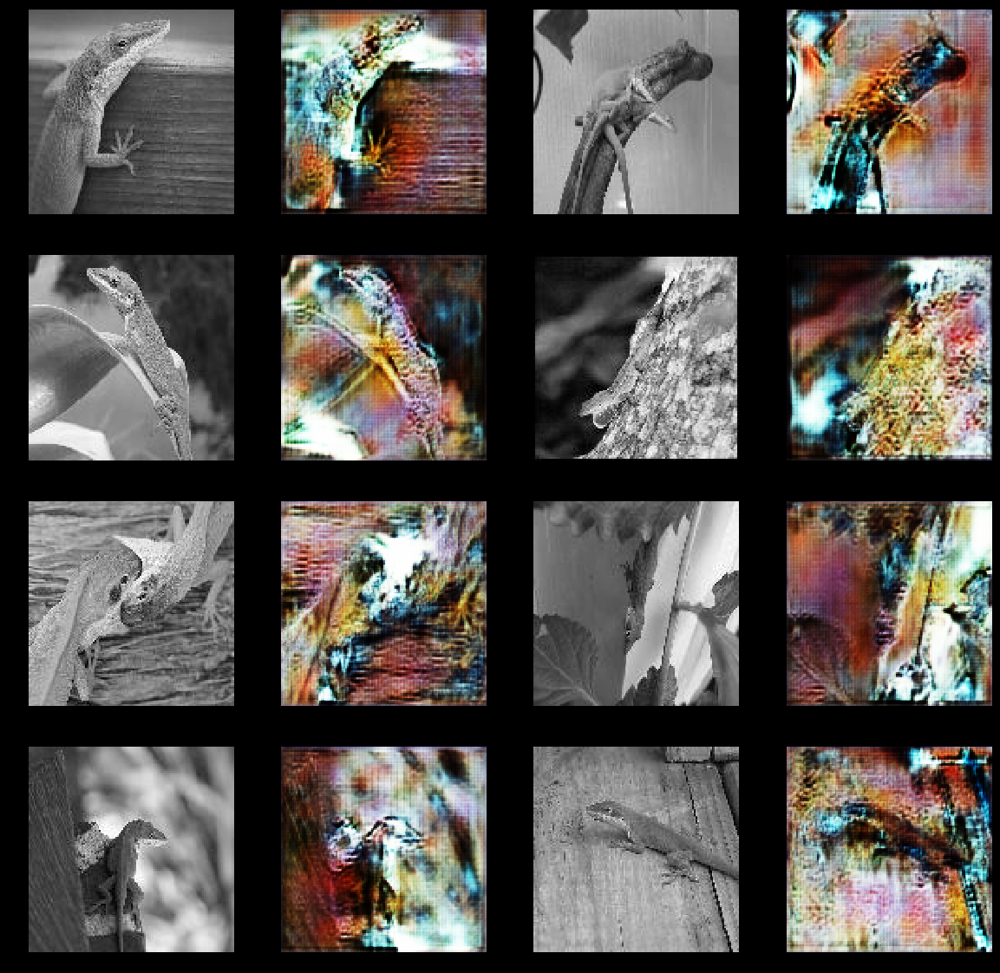

 15%|█▍        | 11550/79264 [2:28:58<13:03:07,  1.44it/s]
WDist -4330.64697265625; GPenalty 402.2686767578125; RScore -5741.07763671875; FScore -10071.724609375; GLoss 9814.646484375
 15%|█▍        | 11600/79264 [2:29:34<13:03:13,  1.44it/s]
WDist -10230.9970703125; GPenalty 4385.6162109375; RScore -854.5263061523438; FScore -11085.5234375; GLoss 5283.0400390625
 15%|█▍        | 11650/79264 [2:30:15<17:04:01,  1.10it/s]
WDist -17054.1484375; GPenalty 2363.0048828125; RScore 7417.7431640625; FScore -9636.40625; GLoss 11863.77734375
 15%|█▍        | 11700/79264 [2:30:51<13:03:17,  1.44it/s]
WDist -12862.552734375; GPenalty 1275.607177734375; RScore 2101.93603515625; FScore -10760.6162109375; GLoss 11320.173828125
 15%|█▍        | 11750/79264 [2:31:27<13:01:52,  1.44it/s]
WDist -4367.9189453125; GPenalty 558.0896606445312; RScore -2672.255126953125; FScore -7040.17431640625; GLoss 7936.2255859375
 15%|█▍        | 11800/79264 [2:32:08<13:02:33,  1.44it/s]
WDist -11137.3740234375; GPenalty

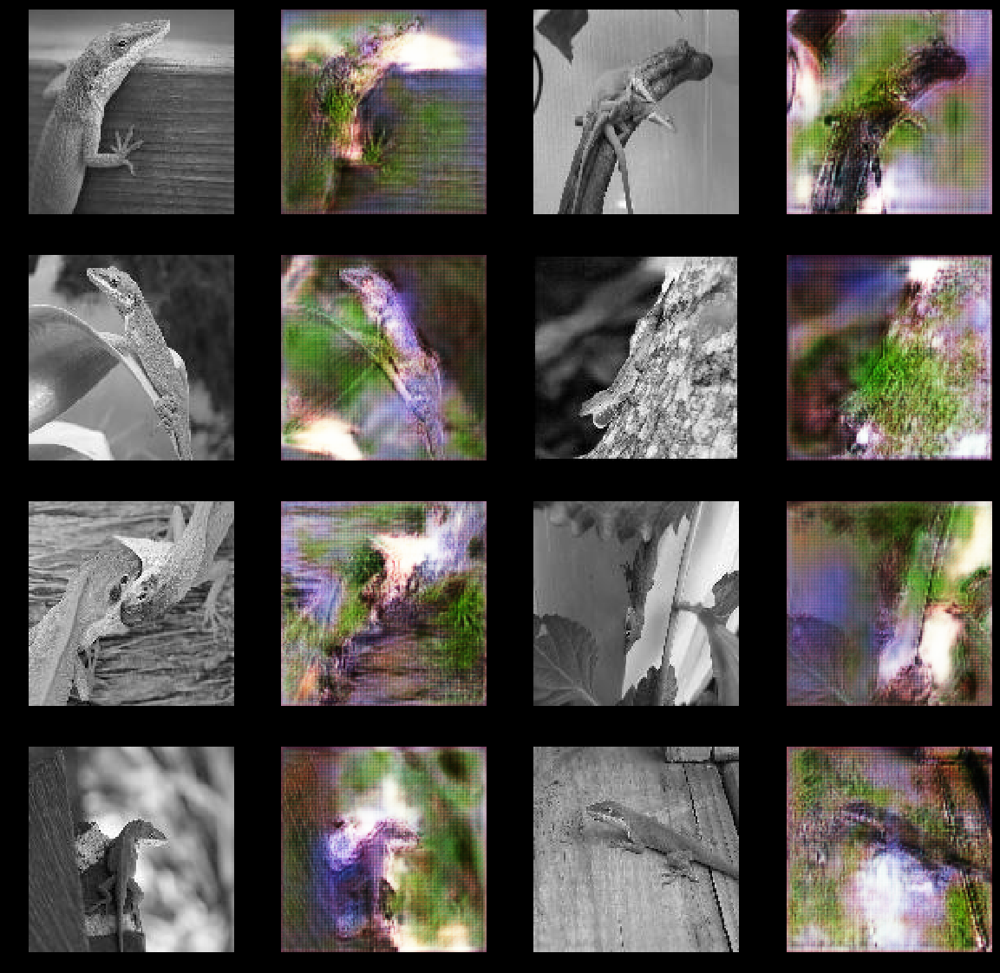

 15%|█▌        | 12050/79264 [2:35:28<13:59:29,  1.33it/s]
WDist -538.6259765625; GPenalty 12.811308860778809; RScore -10946.7138671875; FScore -11485.33984375; GLoss 12358.3046875
 15%|█▌        | 12100/79264 [2:36:04<12:58:15,  1.44it/s]
WDist -5648.0986328125; GPenalty 597.4766845703125; RScore -3207.5107421875; FScore -8855.609375; GLoss 9761.4765625
 15%|█▌        | 12150/79264 [2:36:41<12:57:55,  1.44it/s]
WDist -5782.37890625; GPenalty 893.3261108398438; RScore -3583.814697265625; FScore -9366.193359375; GLoss 11043.6640625
 15%|█▌        | 12200/79264 [2:37:21<12:54:36,  1.44it/s]
WDist -13085.50390625; GPenalty 3501.68701171875; RScore 4243.4384765625; FScore -8842.0654296875; GLoss 10824.240234375
 15%|█▌        | 12250/79264 [2:37:57<12:55:39,  1.44it/s]
WDist -21110.634765625; GPenalty 2450.04052734375; RScore 9628.150390625; FScore -11482.484375; GLoss 12156.7861328125
 16%|█▌        | 12300/79264 [2:38:33<12:55:06,  1.44it/s]
WDist -5840.30029296875; GPenalty 1304.9907226

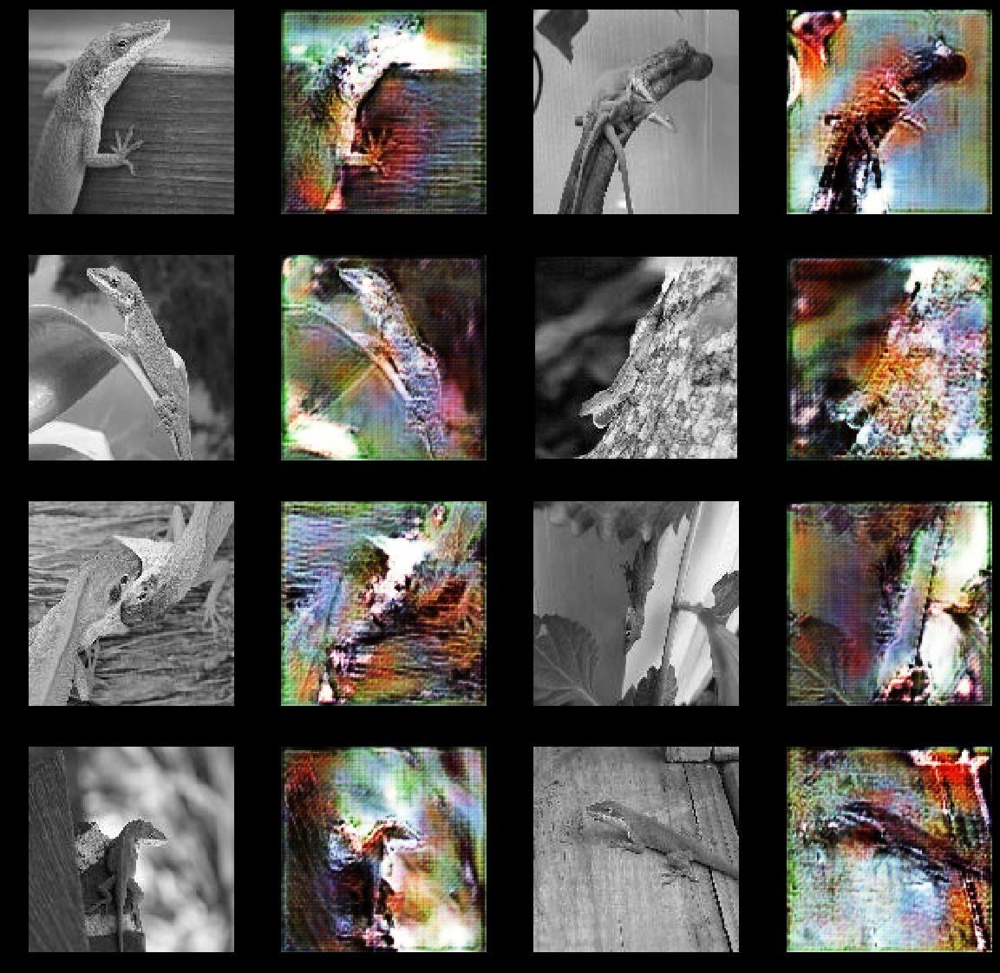

 16%|█▌        | 12550/79264 [2:42:02<12:52:33,  1.44it/s]
WDist -693.22265625; GPenalty 108.25163269042969; RScore -11080.1474609375; FScore -11773.3701171875; GLoss 12538.05859375
 16%|█▌        | 12600/79264 [2:42:43<12:53:26,  1.44it/s]
WDist -18410.064453125; GPenalty 681.7503662109375; RScore 6210.25732421875; FScore -12199.806640625; GLoss 12854.4609375
 16%|█▌        | 12650/79264 [2:43:19<12:50:58,  1.44it/s]
WDist -1643.60546875; GPenalty 181.4954833984375; RScore -10532.734375; FScore -12176.33984375; GLoss 13468.5947265625
 16%|█▌        | 12782/79264 [2:44:51<13:36:23,  1.36it/s]

In [ ]:
train(1, True)
#train(1, False)

In [ ]:
train(9, False)